# Filtering atlas: Smajic

<div class="alert alert-warning">

**What this notebook does**

In this notebook, the h5ad files of Altena et al. will be filtered based on previously calculated quality control metrics such as doublet score, total counts, and percentages mitochondrial and ribosomal counts. Resulting datasets are written to filtered_[atlas_name]_base.h5ad files.
</div>  

### Loading libraries
Using sc2_seurat environment

In [1]:
import sys
print(sys.executable)
print(sys.version)
print(sys.version_info)

/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/bin/python
3.9.9 | packaged by conda-forge | (main, Dec 20 2021, 02:40:17) 
[GCC 9.4.0]
sys.version_info(major=3, minor=9, micro=9, releaselevel='final', serial=0)


In [2]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))#embed HTML within IPython notebook and make containers 90% of screen
import numpy as np
import pandas as pd
import scanpy as sc
import seaborn as sns
import os
import matplotlib.pyplot as plt

%matplotlib inline
sc.settings.verbosity = 0             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, facecolor='white') #figure resolution and background color

# This is used
# os.path.join('data/'+object_names[i][6:10]+'_preprocessed.h5ad')
#sc.logging.print_versions()

## Load data
The filtered .h5ad  files from preprocessing section.

In [3]:
path='/home/hers_basak/jjiang/jack/outputs/deliverables/1_preprocessing/data/preprocessed_'
SRR12621867=f'{path}smajic_SRR12621867.h5ad'
SRR12621868=f'{path}smajic_SRR12621868.h5ad'
SRR12621869=f'{path}smajic_SRR12621869.h5ad'
SRR12621870=f'{path}smajic_SRR12621870.h5ad'
SRR12621871=f'{path}smajic_SRR12621871.h5ad'
SRR12621872=f'{path}smajic_SRR12621872.h5ad'


In [4]:
!ls /home/hers_basak/jjiang/jack/outputs/deliverables/2_filtering/data/

filtered_agarwal_base_GSM4157068.h5ad
filtered_agarwal_base_GSM4157069.h5ad
filtered_agarwal_base_GSM4157070.h5ad
filtered_agarwal_base_GSM4157072.h5ad
filtered_agarwal_base_GSM4157074.h5ad
filtered_agarwal_base_GSM4157076.h5ad
filtered_agarwal_base_GSM4157078.h5ad
filtered_altena_base_g004.h5ad
filtered_altena_base_g005.h5ad
filtered_altena_base_g011.h5ad
filtered_altena_base_g012.h5ad
filtered_altena_base_g013.h5ad
filtered_altena_base_g014.h5ad
filtered_altena_base_g015.h5ad
filtered_altena_base_g016.h5ad
filtered_altena_base_g017.h5ad
filtered_altena_base_g018.h5ad
filtered_altena_base_g019.h5ad
filtered_altena_base_g020.h5ad
filtered_siletti_base_S173_3.h5ad
filtered_siletti_base_S173_4.h5ad
filtered_siletti_base_S173_5.h5ad
filtered_siletti_base_S175_7.h5ad
filtered_siletti_base_S175_8.h5ad
filtered_siletti_base_S176_1.h5ad
filtered_siletti_base_S176_2.h5ad
filtered_siletti_base_S193_1.h5ad
filtered_siletti_base_S193_2.h5ad
filtered_siletti_base_S194_4.h5ad
filtered_siletti_base_

In [5]:
#set data path
os.chdir('/home/hers_basak/jjiang/jack/outputs/deliverables/2_filtering')

In [6]:
os.getcwd()

'/hpc/hers_basak/rnaseq_data/Basaklab/jjiang/outputs/deliverables/2_filtering'

In [7]:
files = [SRR12621867,SRR12621868,SRR12621869,SRR12621870,SRR12621871,SRR12621872]

In [8]:
names = [name.split('smajic_')[1].split('.h5ad')[0] for name in files ]
print(names)

['SRR12621867', 'SRR12621868', 'SRR12621869', 'SRR12621870', 'SRR12621871', 'SRR12621872']


In [9]:
object_names_preprocessed =list()
numberobj = len(files)

for i in range(numberobj):
    object_names_preprocessed.append("adata"+"_"+names[i]+"_"+"preprocessed")
    locals()[object_names_preprocessed[i]] = sc.read(files[i]) 
    print(object_names_preprocessed[i],' is loaded')

adata_SRR12621867_preprocessed  is loaded
adata_SRR12621868_preprocessed  is loaded
adata_SRR12621869_preprocessed  is loaded
adata_SRR12621870_preprocessed  is loaded
adata_SRR12621871_preprocessed  is loaded
adata_SRR12621872_preprocessed  is loaded


In [25]:
k=['AAGTACCAGCTGTACT-1', 'AATAGAGAGAGCCGAT-1', 'ACACAGTTCTTAGCAG-1', 'ACCCTTGTCCACTGGG-1', 'ACGGGTCGTTCCTAGA-1', 'ACTTTCAGTATGCTTG-1', 'AGAACCTCACCGGCTA-1', 'AGACCATTCCTCCACA-1', 'AGAGAGCAGCAACCAG-1', 'AGCGCCAGTGGATCGA-1', 'AGTCAACGTTCGGTCG-1', 'CAACCAATCTCCAAGA-1', 'CACATGATCGCTGTCT-1', 'CCGTAGGCACTAGTAC-1', 'CCGTGAGTCCCAGTGG-1', 'CGACAGCGTGGCCACT-1', 'CGAGTGCCAGCAGATG-1', 'CGGGTCATCAGCATTG-1', 'CTCCGATTCAAGTGGG-1', 'CTGCCATCACCCAAGC-1', 'GAAGAATGTCACTTAG-1', 'GAATAGAGTAGTATAG-1', 'GACACGCGTCGATTCA-1', 'GACCTTCGTCCTGTTC-1', 'GACTTCCAGGGAGGAC-1', 'GATCATGGTAACATAG-1', 'GGGTCACAGCGTTACT-1', 'GGTGAAGAGAGTCAGC-1', 'GTTGTAGGTGGCCACT-1', 'GTTGTGACAGACAAGC-1', 'TCTCCGATCCGGACGT-1', 'TGAATCGGTAGCTGAG-1', 'TGACAGTTCTGAGTCA-1', 'TGTTTGTCACGCTTAA-1', 'TTGATGGAGGCCTGAA-1', 'TTTCATGAGAACGTGC-1', 'TTTGGAGTCATGCCGG-1', 'AACCACACAACGCCCA-1', 'ACAGCCGGTGTCCTAA-1', 'AGGGTGACACATATGC-1', 'ATACCGATCTACGCAA-1', 'ATCACGAGTATGAGAT-1', 'ATCCGTCCAATACGAA-1', 'CAACGATCAGACCATT-1', 'CACATGACAATTGGTC-1', 'CACTTCGGTTTACGTG-1', 'CAGCGTGTCCGACGGT-1', 'CAGGTATCACATACTG-1', 'CATTTCAGTTTCACTT-1', 'CCATCACAGTGGCGAT-1', 'CCTCACAGTCGCTTAA-1', 'CCTCTCCAGGATGCGT-1', 'CGCGTGATCCCATAGA-1', 'CGGCAGTCAGACCGCT-1', 'CTCATGCAGGTACAGC-1', 'CTGAGGCGTCCGGTGT-1', 'GAAGGACTCTTCCAGC-1', 'GACCCAGTCAACCCGG-1', 'GAGATGGAGGTTGTTC-1', 'GATAGAAGTTGGACCC-1', 'GCCAGGTCAGAGAATT-1', 'GCCAGTGTCTTCGATT-1', 'GGAATGGAGACATATG-1', 'GGAGATGGTAACGTTC-1', 'GGGATGAGTAGGTGCA-1', 'GTCATTTCACATTGTG-1', 'TAAGCCATCAAATGCC-1', 'TACTTGTAGGGCAAGG-1', 'TATGTTCCAGAGATTA-1', 'TATGTTCGTCGAAGCA-1', 'TCCACCAAGTGGACGT-1', 'TCCTAATCAGTCACGC-1', 'TGACGCGAGGATCATA-1', 'TGAGCATAGCCTTGAT-1', 'TGATTTCGTTGCATGT-1', 'TGTTCCGGTCAAGTTC-1', 'TTACTGTTCGTAGAGG-1', 'TTCAGGACAGGAGGTT-1', 'TTCTTCCCAGGCTTGC-1', 'TTGACCCCATCCTTGC-1', 'TTGGTTTAGGCATTTC-1', 'TTTCACATCTCTCGCA-1', 'TTTGACTGTCATCAGT-1', 'AACGTCACACGCGTCA-1', 'AAGACAAAGTTTCGGT-1', 'AGAAGTACAACGGCCT-1', 'CATTCTAAGATGTTCC-1', 'CGCGTGATCCCTCATG-1', 'CTGTATTTCTACTATC-1', 'GCACTAACAGAGGTTG-1', 'GTGAGTTCACAGTACT-1', 'TATACCTCATATAGCC-1', 'TCATTGTAGGTCATAA-1', 'TGGATGTCAGCTGCCA-1', 'CAATGACAGGCAGGTT-1', 'CCATAAGTCCATGCAA-1', 'AGAGCAGGTTGGAGAC-1', 'ACGGGTCTCGTCGGGT-1', 'ACTATCTAGCACGATG-1', 'AGGACGAAGATGAATC-1', 'ATCATTCAGCGTGCTC-1', 'CAAGCTACACTGTGTA-1', 'CACCAAACACGCTGAC-1', 'CATGGTATCTGTCCGT-1', 'CCGAACGCAAATCGGG-1', 'CTCAACCGTTGAGTCT-1', 'CTCCCTCAGGCACTCC-1', 'CTGCCTAGTGAACTAA-1', 'GAGAGGTCAGCCCACA-1', 'GCTACAAAGTATGGCG-1', 'GGAGCAAAGCAACTTC-1', 'GTCACTCGTTCGGCTG-1', 'TACCTGCTCTTTCGAT-1', 'TAGATCGAGAGTGTTA-1', 'TCAAGACTCATCGTAG-1', 'TCATATCCATCTCAAG-1', 'TCATTACCACCTCTAC-1', 'TCTAACTAGCGGGTTA-1', 'TTACCATGTACTCAAC-1', 'TTAGGCACAATAGTAG-1']

In [34]:
c=0
for i in range(numberobj):
    celltype=[]
    for j in locals()[object_names_preprocessed[i]].obs_names:
        if j in k:
            celltype.append('CADPS2+ neurons')
            c+=1
        else:
            celltype.append('')
    locals()[object_names_preprocessed[i]].obs['celltype']=celltype


In [35]:
c

5

In [33]:
for i in range(numberobj):
    print(np.median(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['celltype']=='CADPS2+ neurons']['n_genes'].tolist()))

nan
nan
2764.0
2278.5
2219.0
nan


## Preprocess - Doublets

<div class="alert alert-warning">

**Important note about doublet filtering**
    
Some samples have non 'bimodal' distribution expression, which results in the automatic doublet score threshold to be very high and suspicious doublets to not be filtered out. \
    **TO DO (only when distribution is not bimodal causing the automatic threshold to be too high)** \
I decided to manually set the threshold to 0.20 to see if this captures the suspicious cells. Furthermore to see in UMAP if these cells cluster together or are more dispersed.
    

</div>  

### Check gene counts of high doublet scores
Note the graph shows counts excluding mt ones.

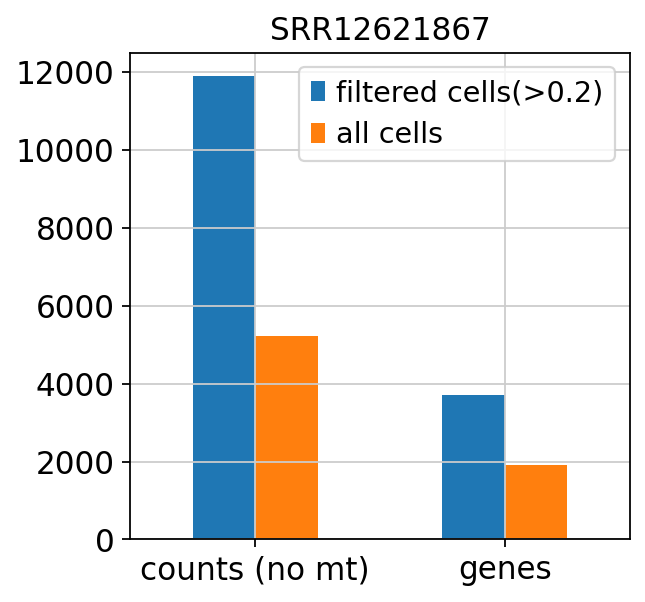

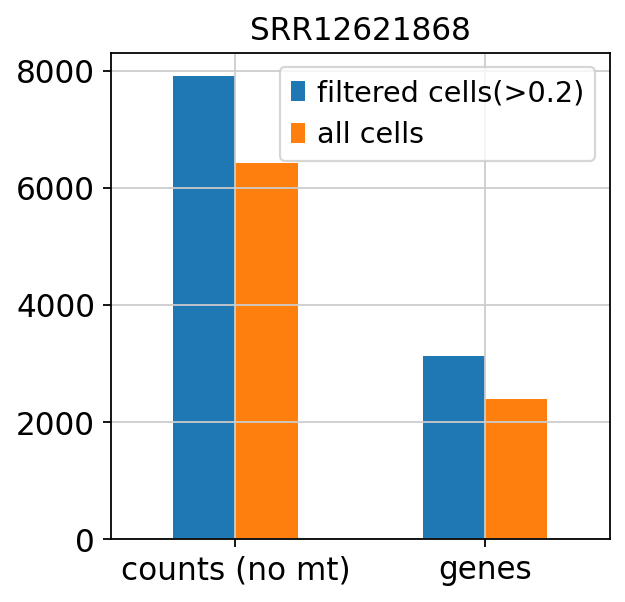

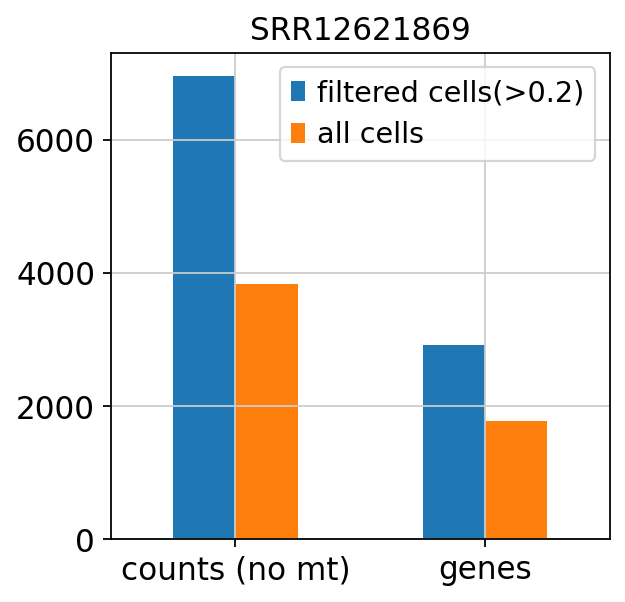

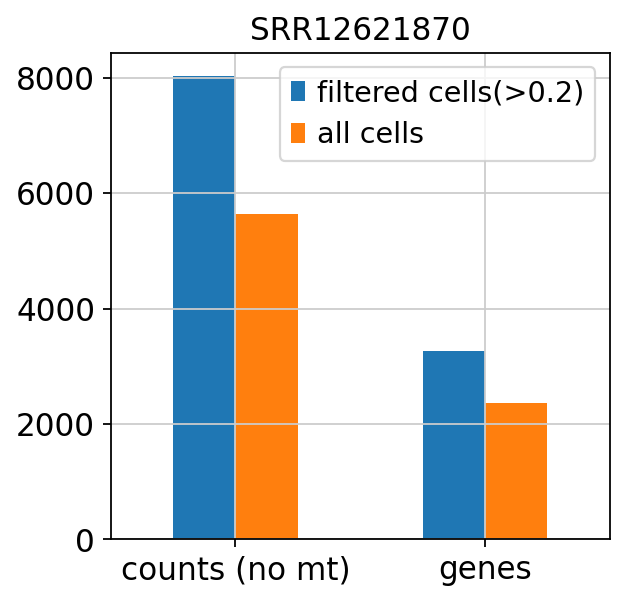

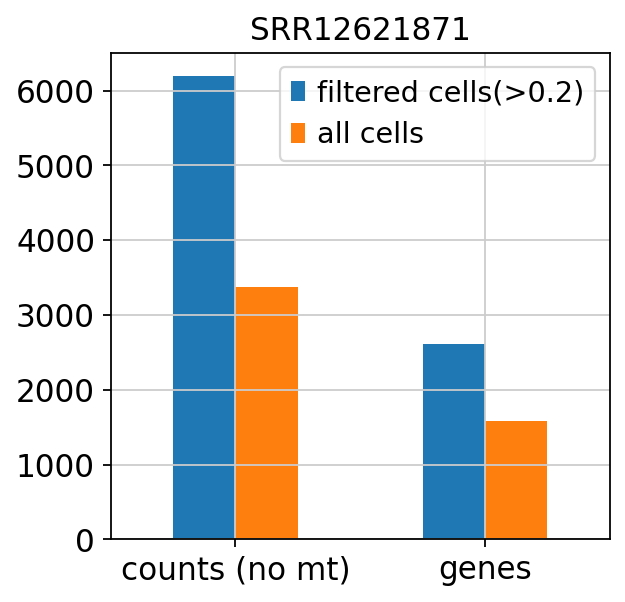

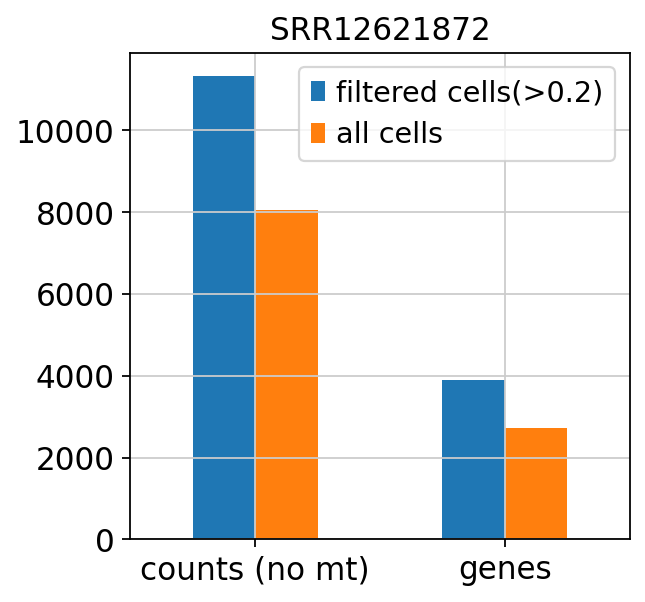

In [31]:
thr =[0.2 for i in range(numberobj)]
for i in range(numberobj):
    mean_counts_high = int(np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['doublet_score'] > thr[i]]['total_counts']))
    mean_genes_high = int(np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['doublet_score'] >thr[i]]['n_genes']))
    mean_counts = int(np.mean(locals()[object_names_preprocessed[i]].obs['total_counts']))
    mean_genes = int(np.mean(locals()[object_names_preprocessed[i]].obs['n_genes']))
    
    
    filtered_cells = [mean_counts_high,mean_genes_high]
    all_cells = [mean_counts,mean_genes]
    index = ['counts (no mt)', 'genes']
    
    
    df = pd.DataFrame({f'filtered cells(>{thr[i]})': filtered_cells, 'all cells': all_cells}, index=index)
    
    ax = df.plot.bar(rot=0,title=names[i])
    
    #print(locals()[object_names[i]].obs[locals()[object_names[i]].obs['doublet_score'] >0.25][['doublet_score','total_counts']])


In [26]:
np.mean(locals()[object_names_preprocessed[0]].obs['total_counts'])

5220.726972880528

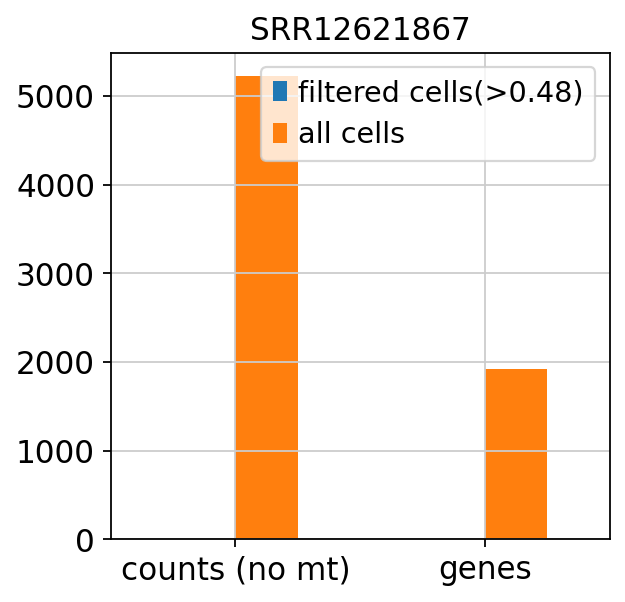

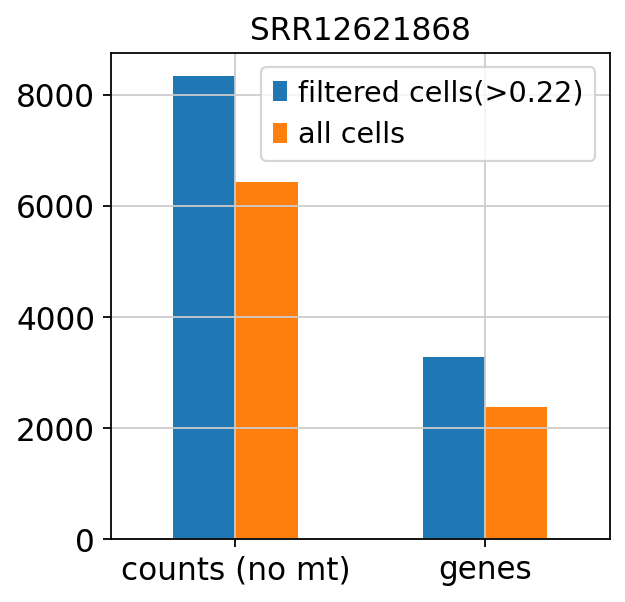

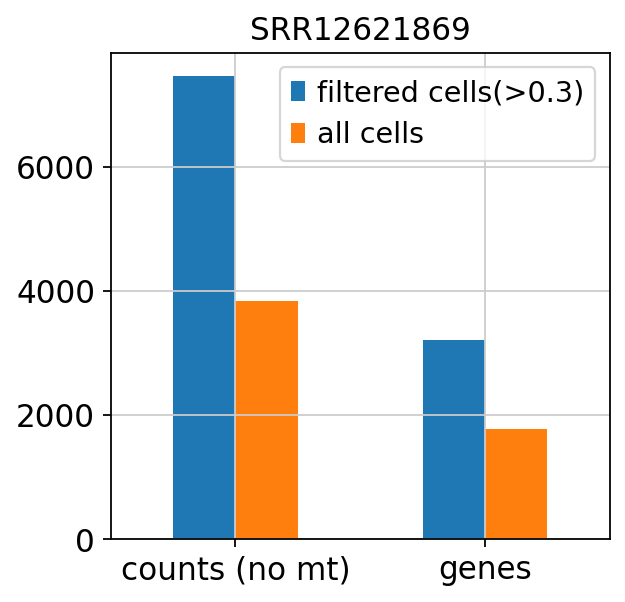

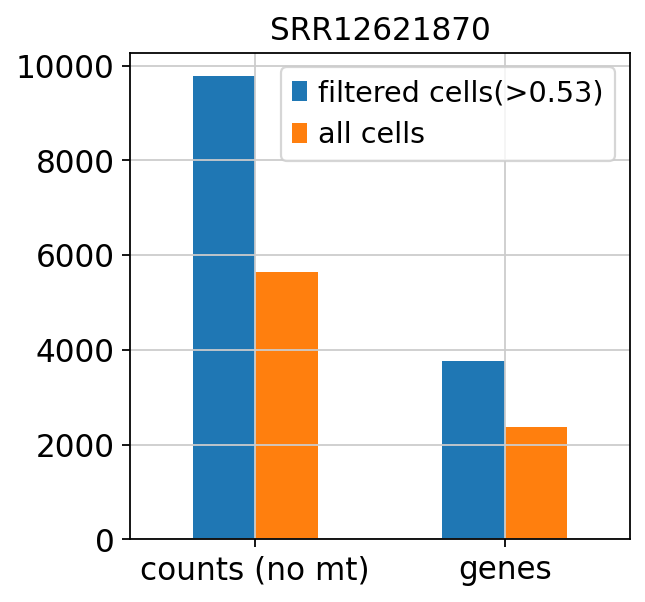

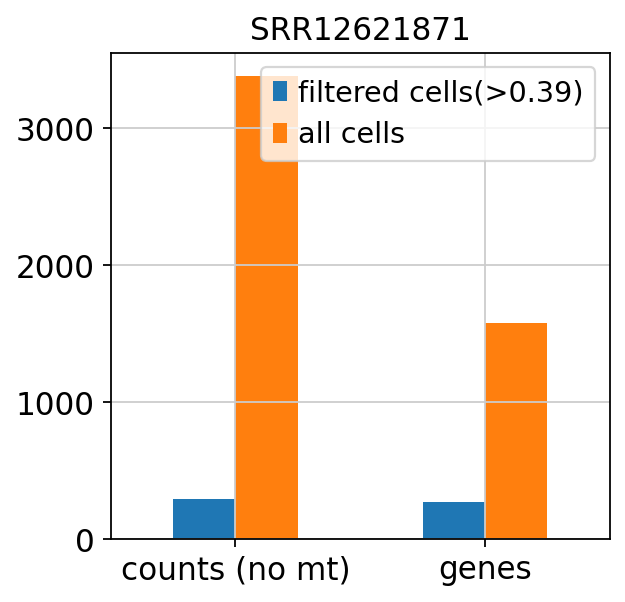

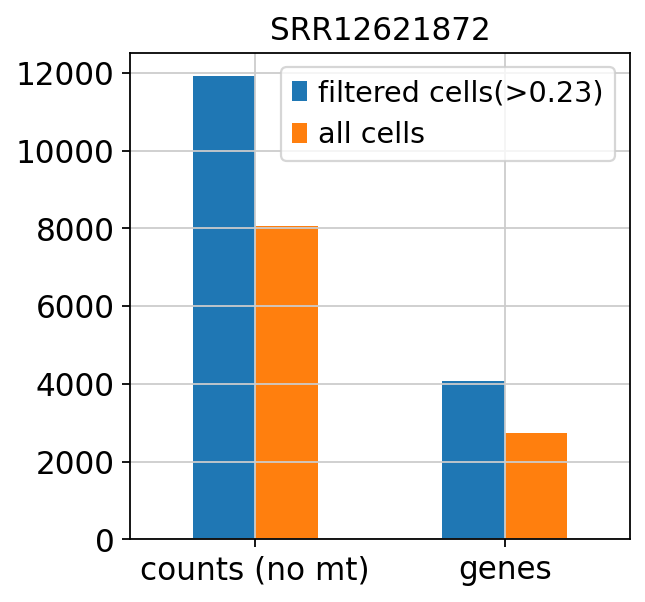

In [32]:
thr =[0.48,0.22,0.30,0.53,0.39,0.23]
for i in range(numberobj):
    mean_counts_high = np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['predicted_doublet'] == 'True']['total_counts'])
    mean_genes_high =np.mean(locals()[object_names_preprocessed[i]].obs[locals()[object_names_preprocessed[i]].obs['predicted_doublet'] == 'True']['n_genes'])
    mean_counts = np.mean(locals()[object_names_preprocessed[i]].obs['total_counts'])
    mean_genes = np.mean(locals()[object_names_preprocessed[i]].obs['n_genes'])
    
    
    filtered_cells = [mean_counts_high,mean_genes_high]
    all_cells = [mean_counts,mean_genes]
    index = ['counts (no mt)', 'genes']
    
    df = pd.DataFrame({f'filtered cells(>{thr[i]})': filtered_cells, 'all cells': all_cells}, index=index)
    ax = df.plot.bar(rot=0,title=names[i])
    
    #print(locals()[object_names[i]].obs[locals()[object_names[i]].obs['doublet_score'] >0.25][['doublet_score','total_counts']])


In [11]:
np.random.seed(41)
%matplotlib inline

normalize samples to compare

In [12]:

for i in range(numberobj):
    locals()['test_'+names[i]]=locals()[object_names_preprocessed[i]].copy()
    
    sc.pp.normalize_total(locals()['test_'+names[i]], key_added='total_counts_norm')
    locals()['test_'+names[i]].raw = locals()['test_'+names[i]].copy()
    sc.pp.log1p(locals()['test_'+names[i]])
    print('test_',names[i], ' has been normalized and logarithmized')
    
    sc.tl.pca(locals()['test_'+names[i]], svd_solver='arpack')
    
    

test_ SRR12621867  has been normalized and logarithmized
test_ SRR12621868  has been normalized and logarithmized
test_ SRR12621869  has been normalized and logarithmized
test_ SRR12621870  has been normalized and logarithmized
test_ SRR12621871  has been normalized and logarithmized
test_ SRR12621872  has been normalized and logarithmized


In [13]:
nn=15
for i in range(numberobj):
    print('test_',names[i], ': done')
    sc.pp.neighbors(locals()['test_'+names[i]], n_neighbors=nn, n_pcs=40)
    sc.tl.umap(locals()['test_'+names[i]])
    
    

test_ SRR12621867 : done
test_ SRR12621868 : done
test_ SRR12621869 : done
test_ SRR12621870 : done
test_ SRR12621871 : done
test_ SRR12621872 : done


SRR12621867


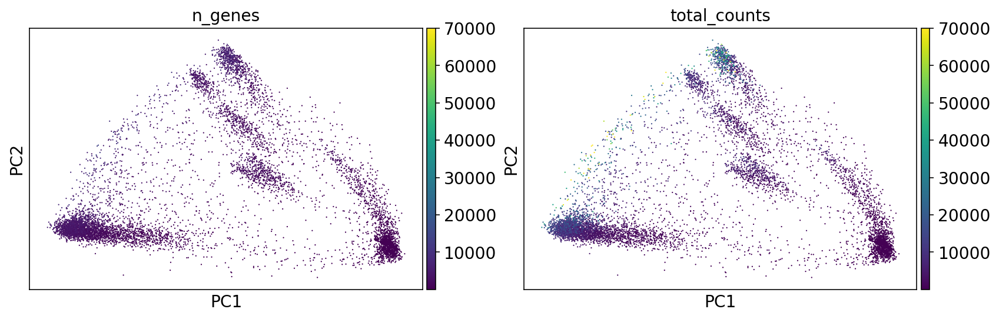

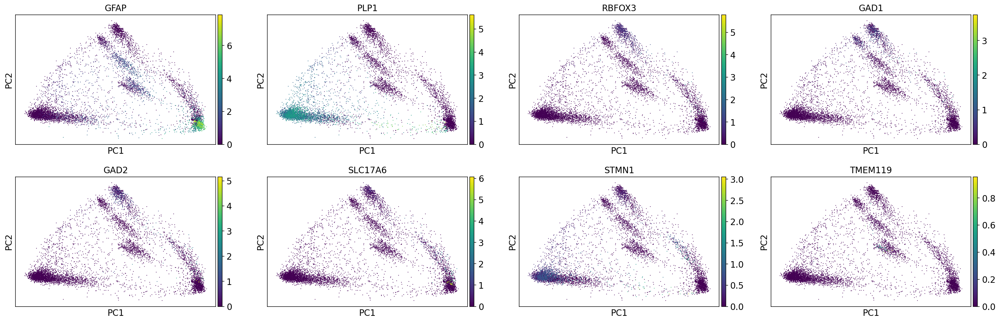

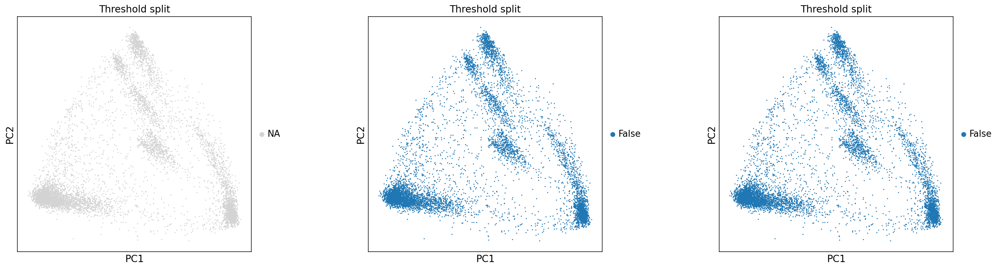

SRR12621868


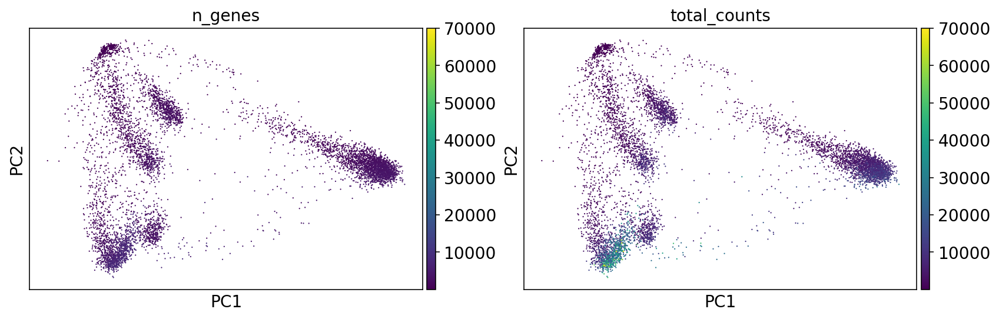

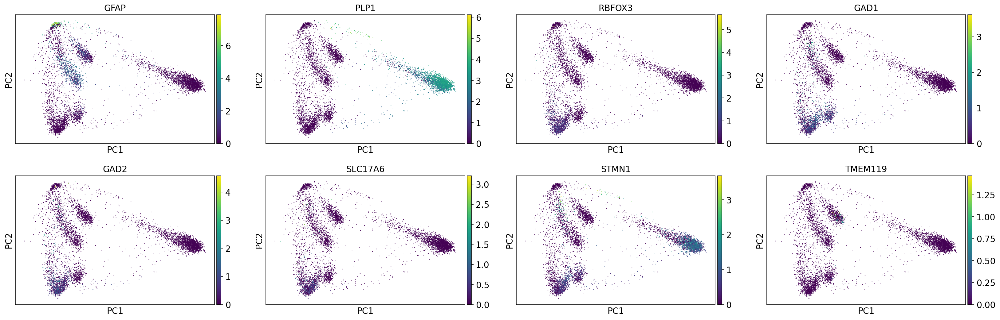

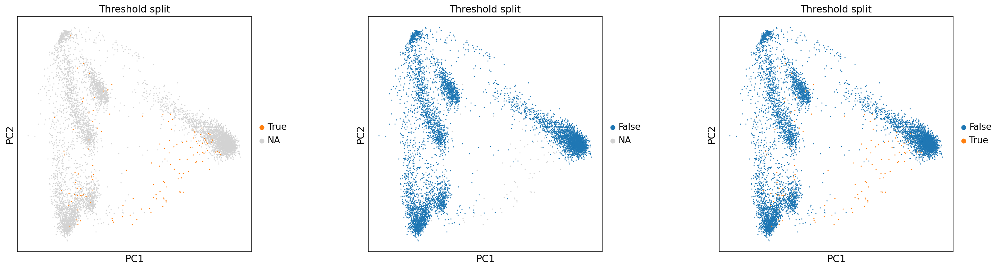

SRR12621869


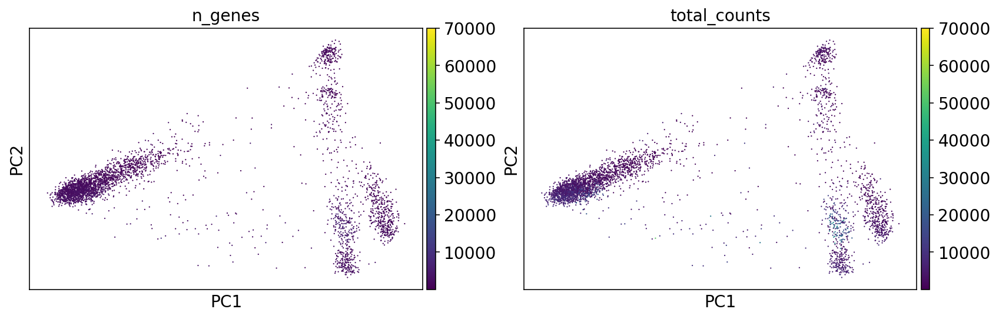

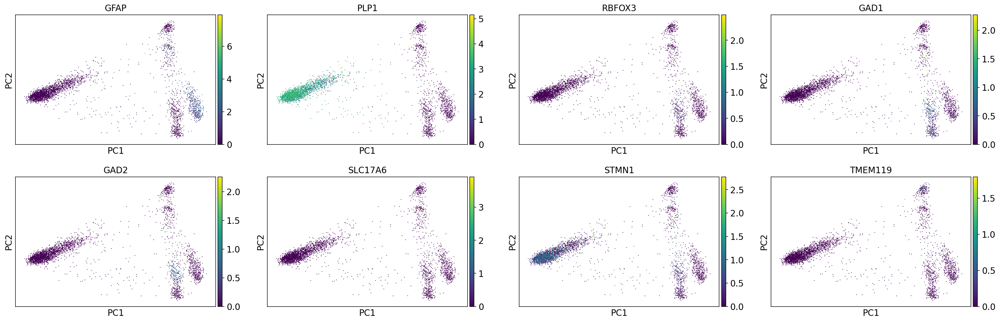

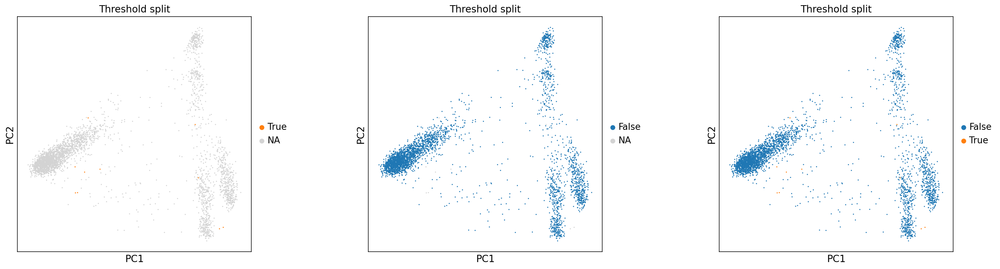

SRR12621870


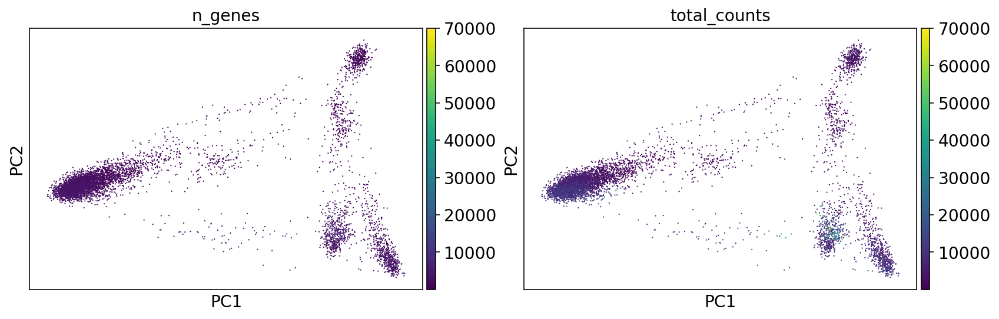

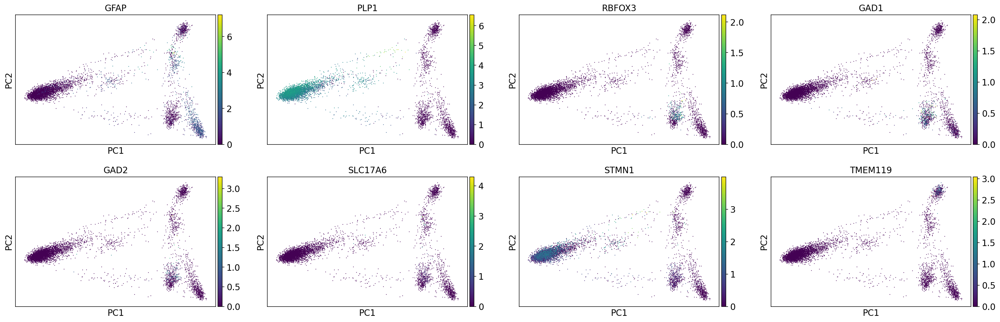

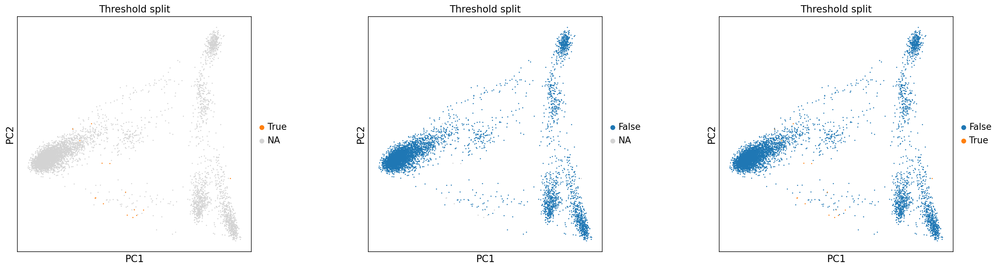

SRR12621871


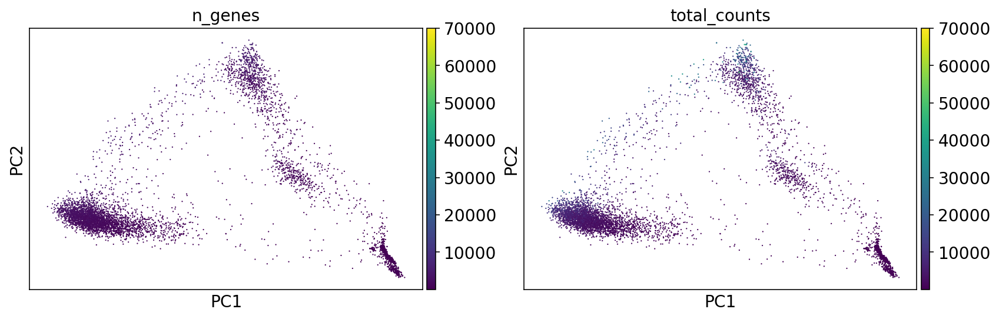

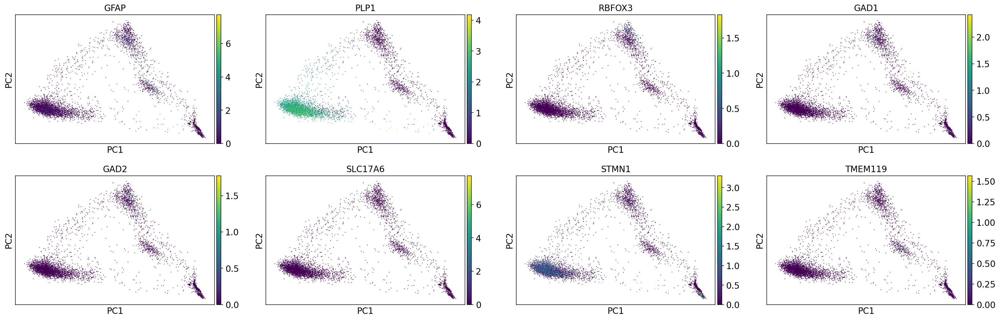

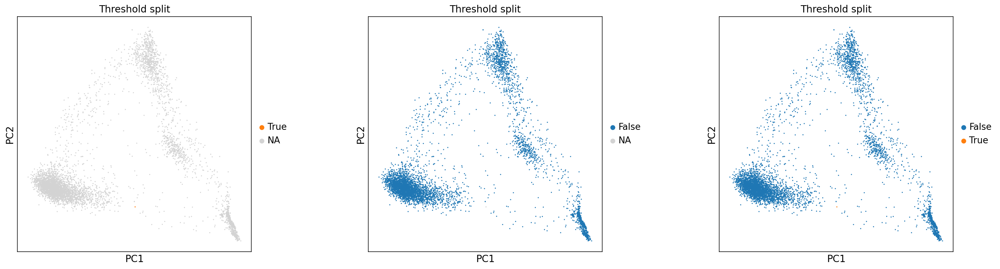

SRR12621872


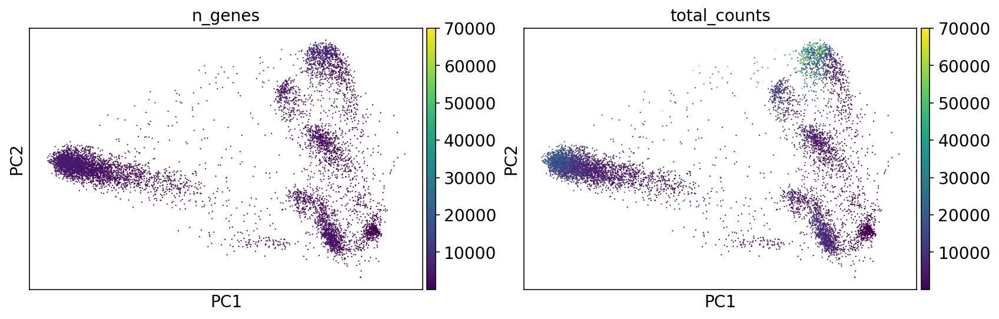

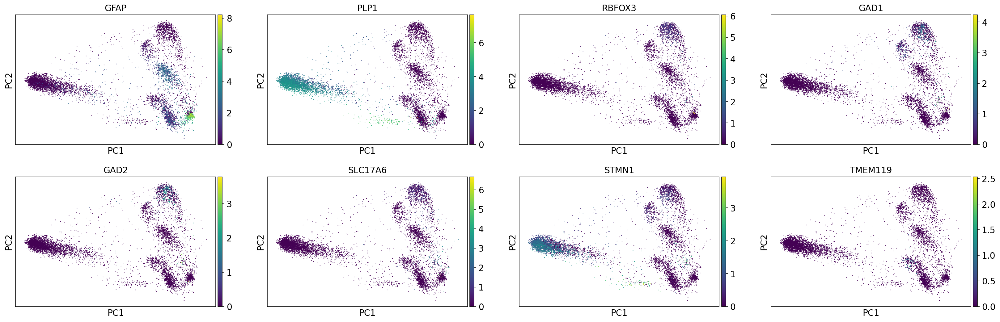

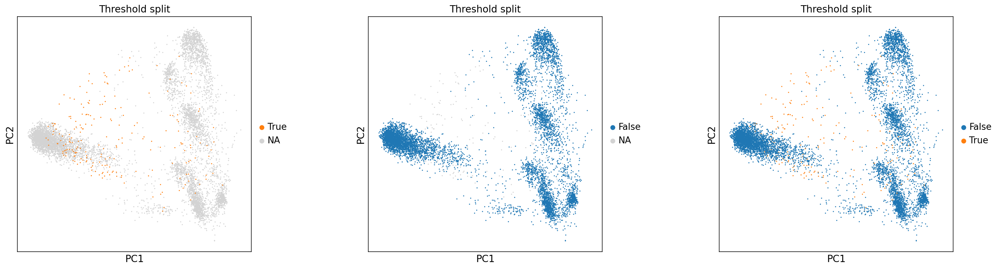

In [36]:
for i in range(numberobj):
    print(names[i])
    
    sc.pl.pca(locals()['test_'+names[i]], color=['n_genes', 'total_counts'],s=5,vmax=70000)
    sc.pl.pca(locals()['test_'+names[i]], color=['GFAP', 'PLP1', 'RBFOX3','GAD1','GAD2', 'SLC17A6','STMN1','TMEM119'], s=5,use_raw=False)
    
    feature= 'predicted_doublet'
    group1= 'True'
    group2= 'False'
    fig, axs = plt.subplots(1, 3, figsize =[24,6])
    #axs[-1, -1].axis('off')
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.5)
    sc.pl.pca(locals()['test_'+names[i]], color=feature, groups= group1, use_raw=False, s=10, ax= axs[0],show=False, title='Threshold split')
    sc.pl.pca(locals()['test_'+names[i]], color=feature, groups= group2, use_raw=False, s=10, ax= axs[1],show=False, title='Threshold split')
    sc.pl.pca(locals()['test_'+names[i]], color=feature, use_raw=False, s=10, ax= axs[2],show=False, title='Threshold split')
    plt.show()

SRR12621867


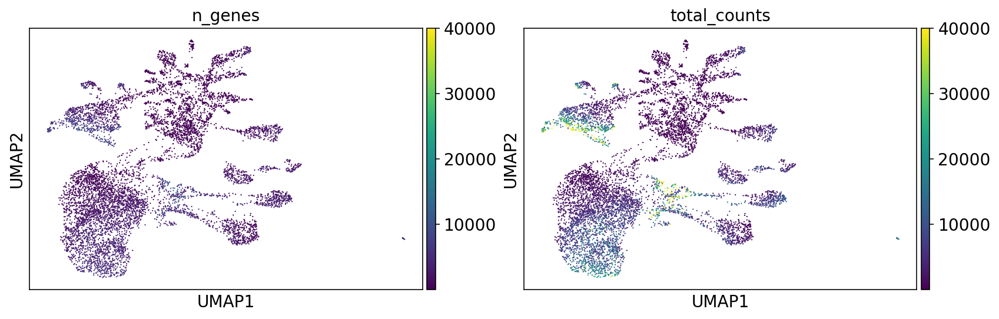

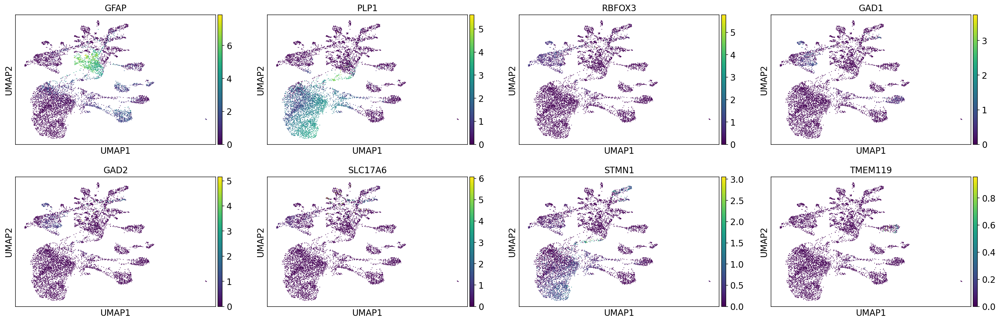

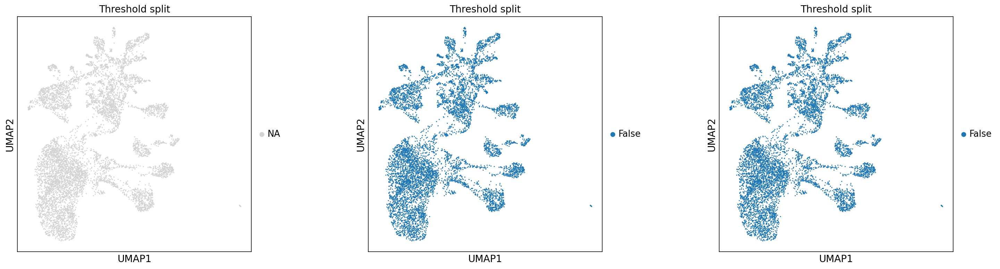

SRR12621868


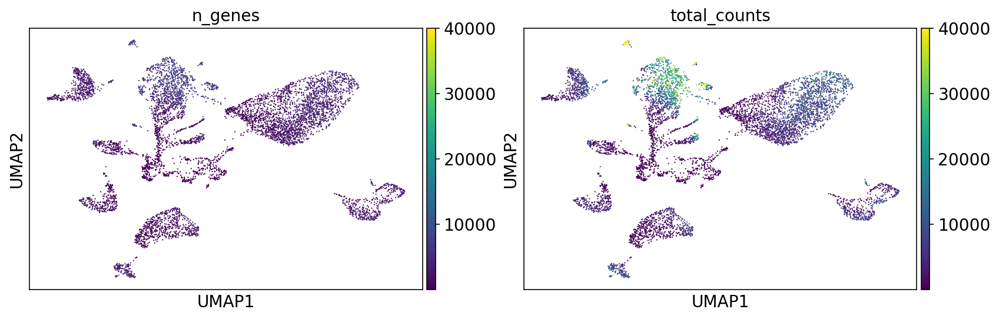

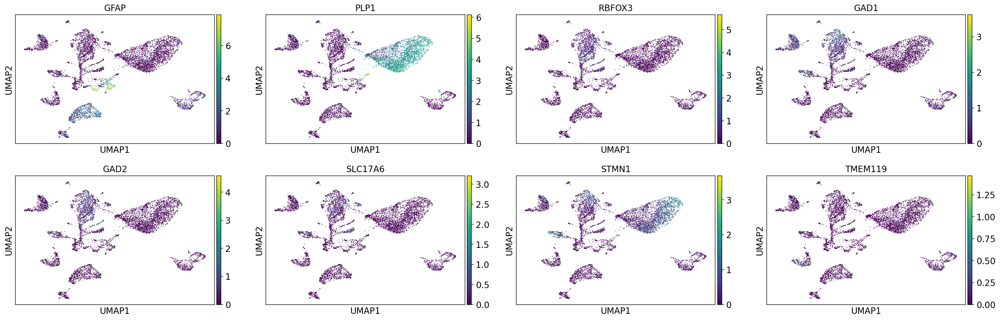

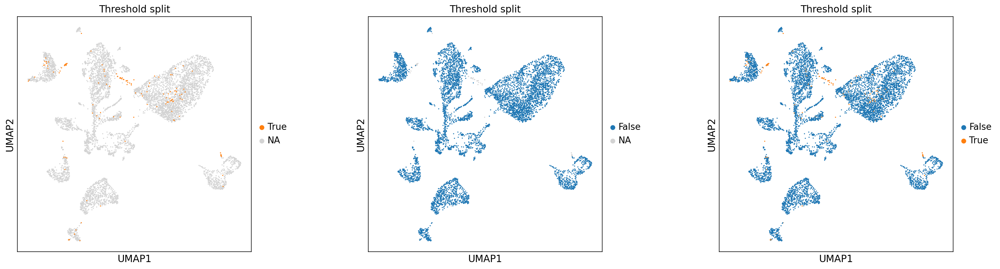

SRR12621869


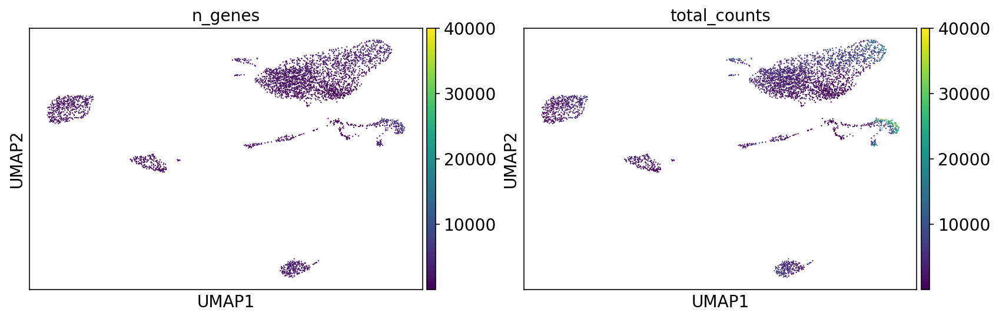

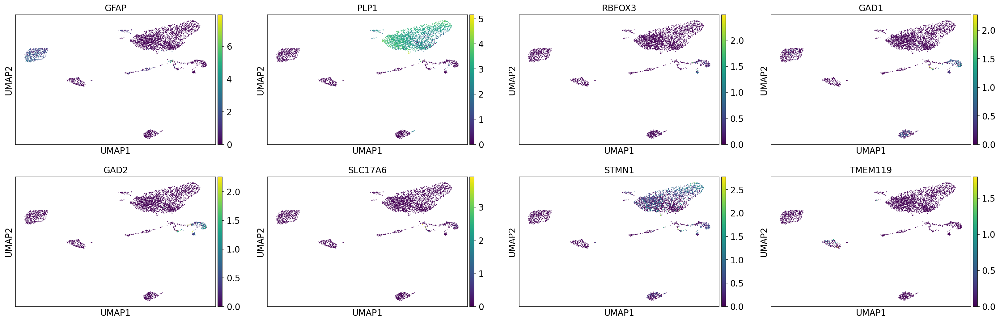

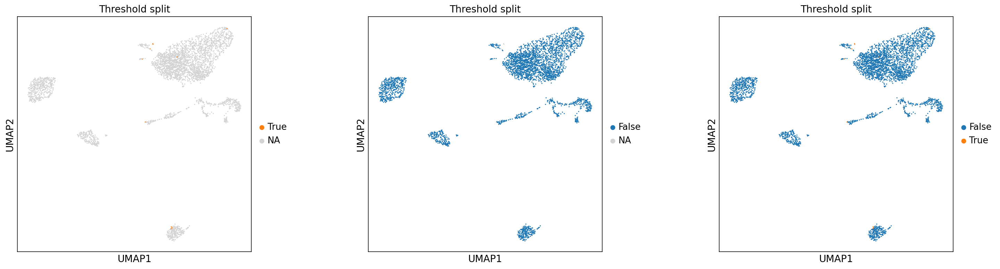

SRR12621870


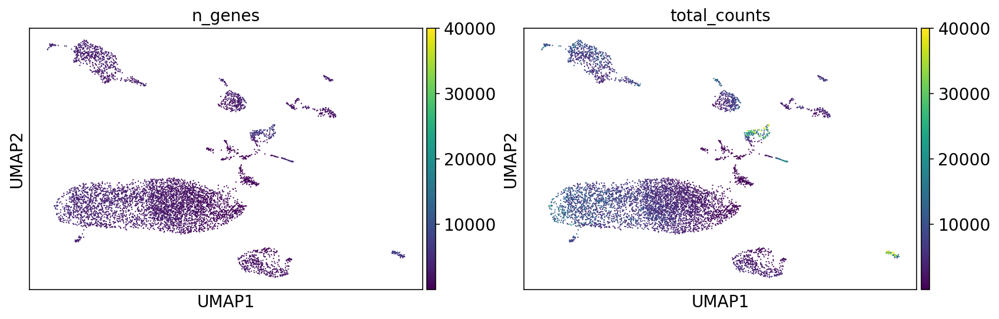

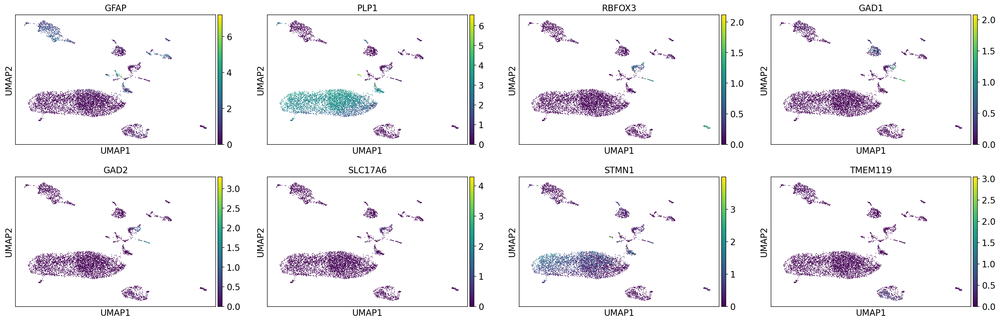

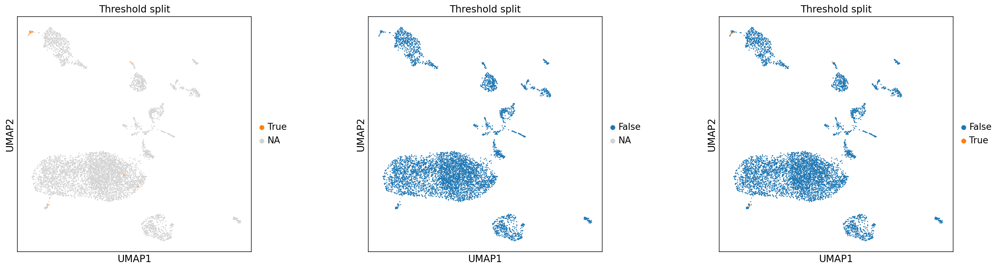

SRR12621871


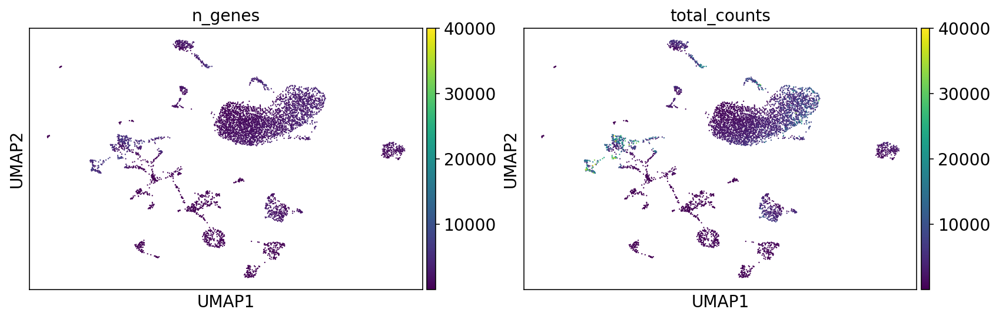

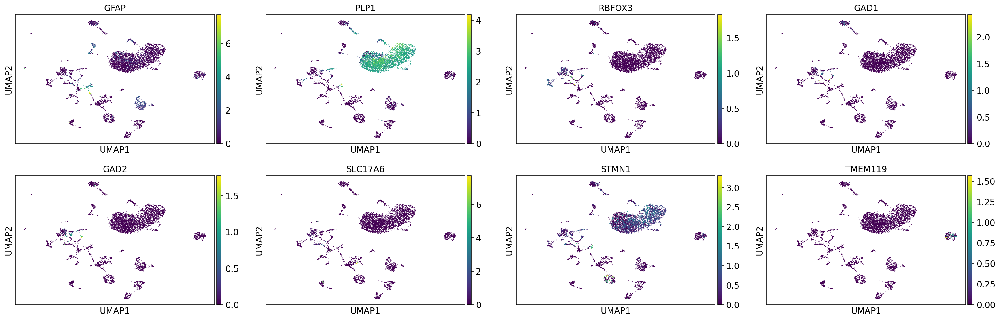

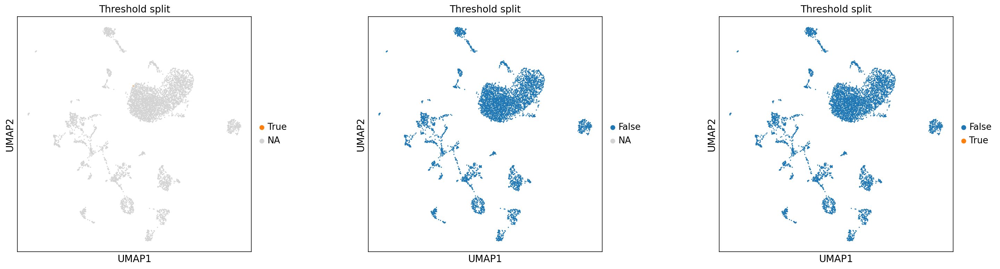

SRR12621872


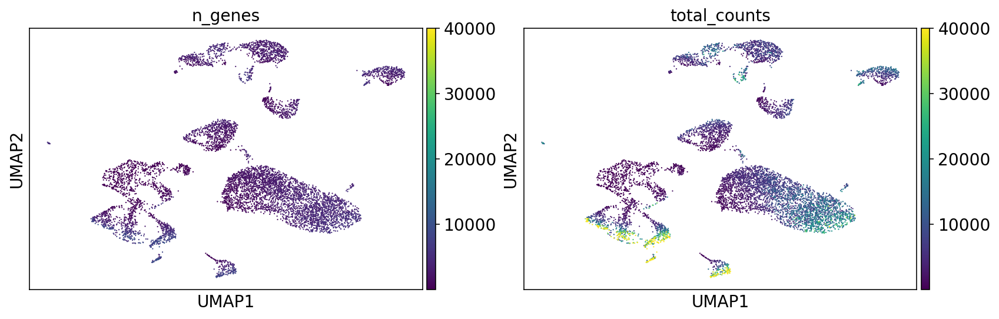

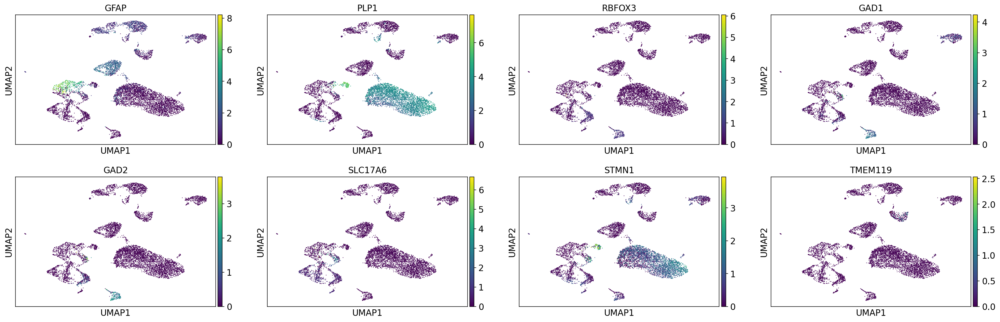

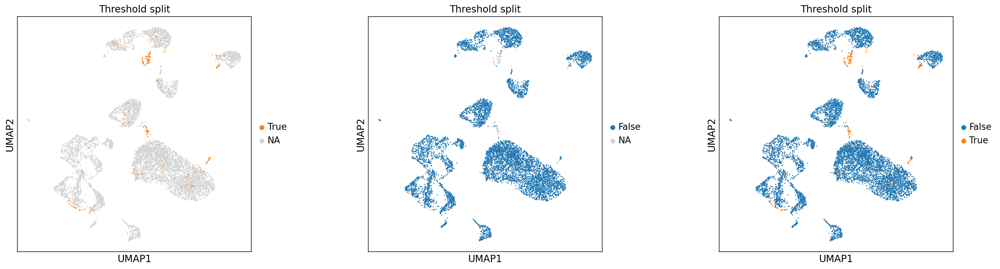

In [40]:

for i in range(numberobj):
    print(names[i])
    
    sc.pl.umap(locals()['test_'+names[i]], color=['n_genes', 'total_counts'],s=5,vmax=40000)
    sc.pl.umap(locals()['test_'+names[i]], color=['GFAP', 'PLP1', 'RBFOX3','GAD1','GAD2', 'SLC17A6','STMN1','TMEM119'], s=5,use_raw=False)
    
    feature= 'predicted_doublet'
    group1= 'True'
    group2= 'False'
    fig, axs = plt.subplots(1, 3, figsize =[24,6])
    #axs[-1, -1].axis('off')
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.5)
    sc.pl.umap(locals()['test_'+names[i]], color=feature, groups= group1, use_raw=False, s=10, ax= axs[0],show=False, title='Threshold split')
    sc.pl.umap(locals()['test_'+names[i]], color=feature, groups= group2, use_raw=False, s=10, ax= axs[1],show=False, title='Threshold split')
    sc.pl.umap(locals()['test_'+names[i]], color=feature, use_raw=False, s=10, ax= axs[2],show=False, title='Threshold split')
    plt.show()

SRR12621867
SRR12621868
SRR12621869
SRR12621870
SRR12621871
SRR12621872


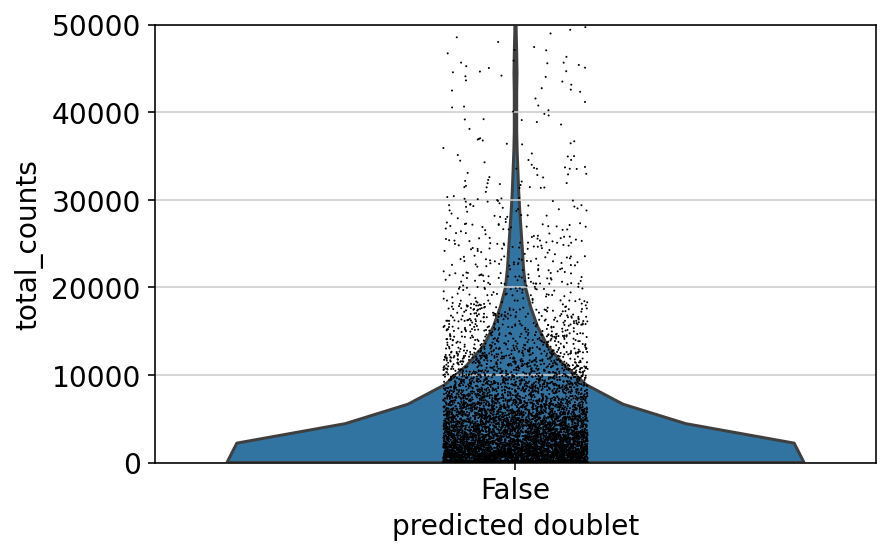

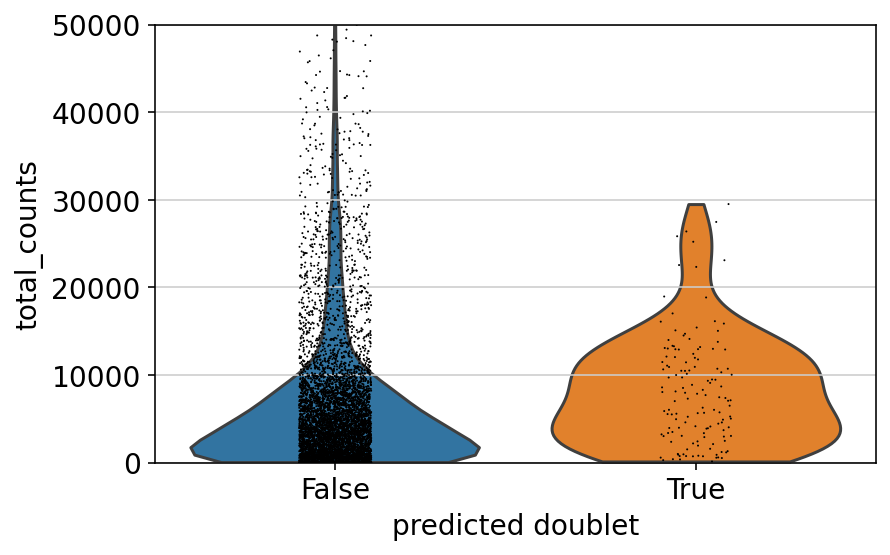

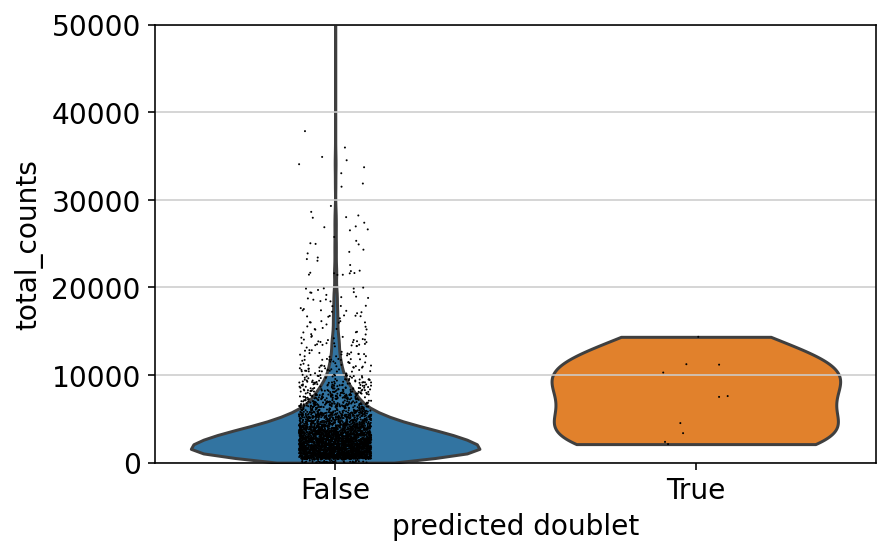

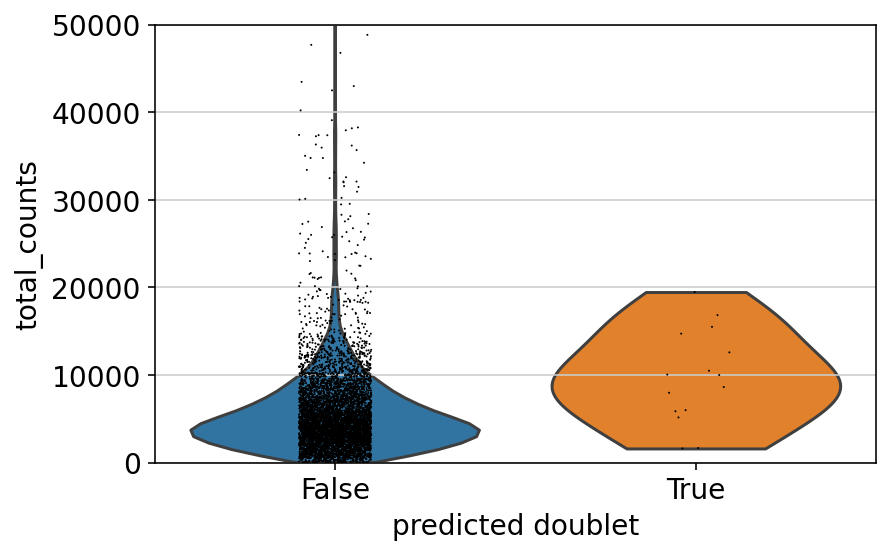

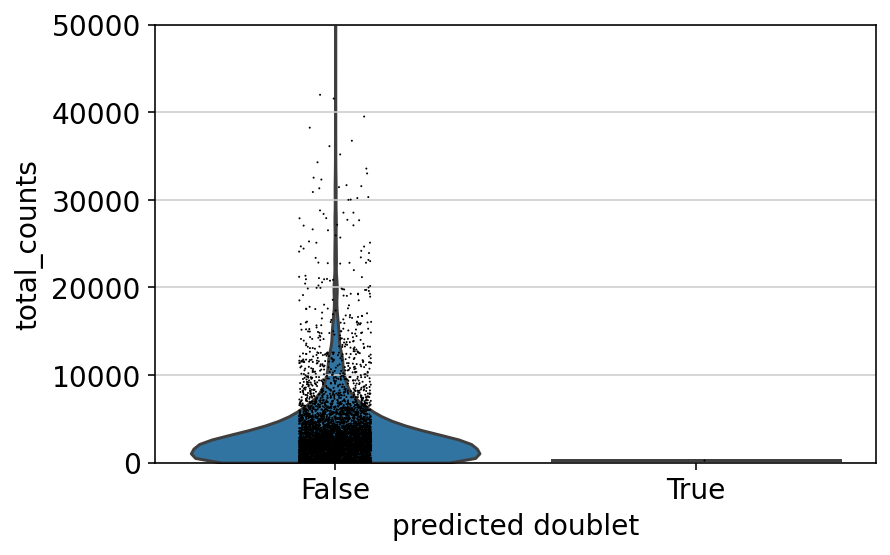

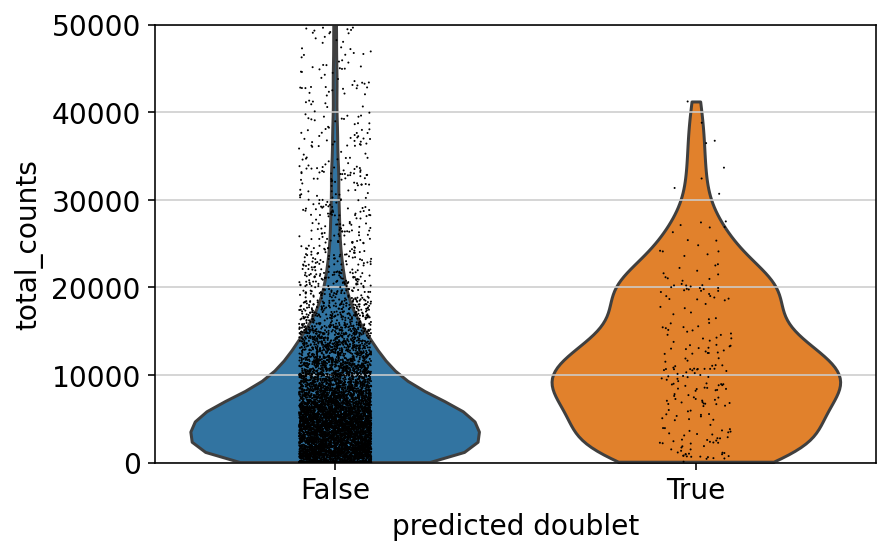

In [53]:
for i in range(numberobj):
    print(names[i])
    ax =sc.pl.violin(locals()['test_'+names[i]], keys='total_counts', groupby='predicted_doublet', show=False)
    ax.set_ylim(bottom=0,top=50000)

SRR12621867
SRR12621868
SRR12621870
SRR12621871


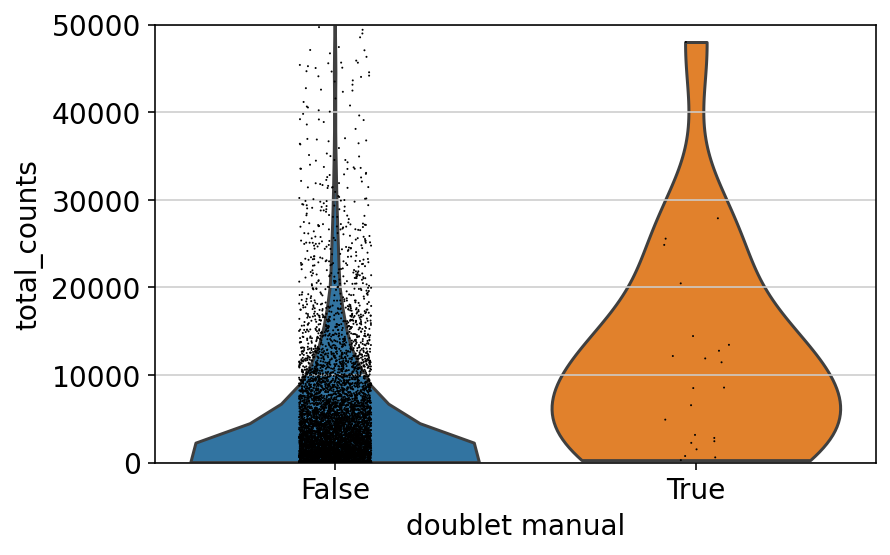

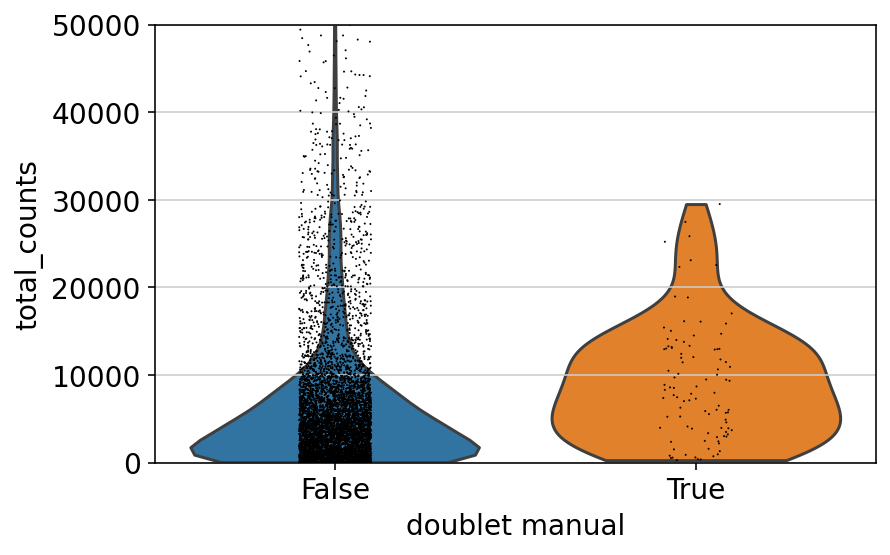

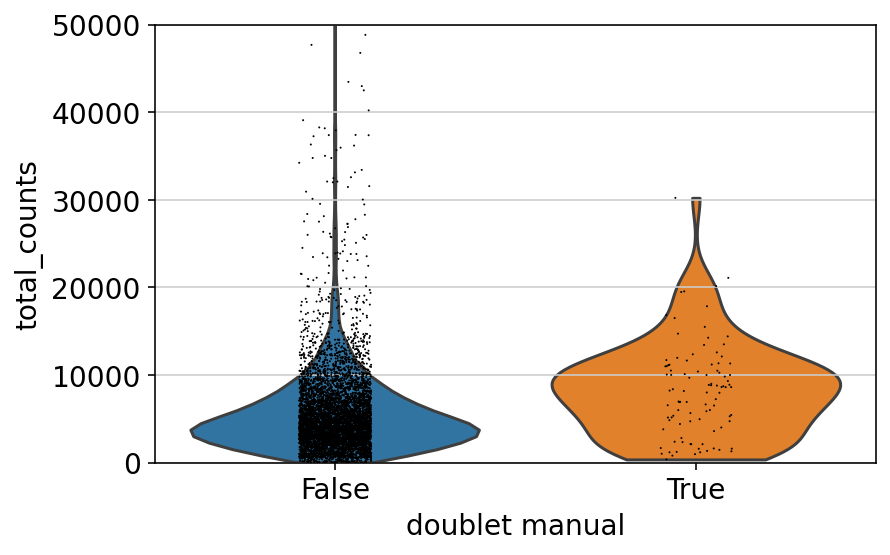

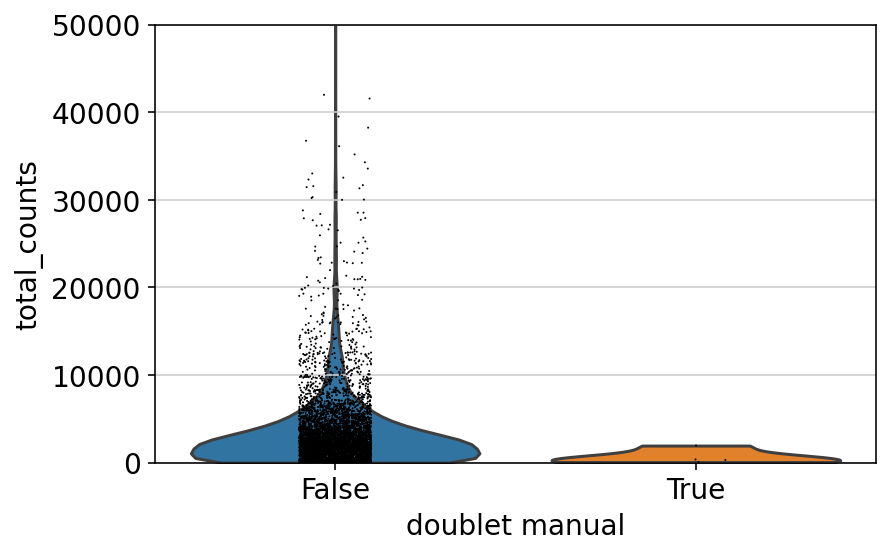

In [51]:
for i in [0,1,3,4]:
    print(names[i])
    ax =sc.pl.violin(locals()['test_'+names[i]], keys='total_counts', groupby='doublet_manual',vlim=50000, show=False)
    ax.set_ylim(bottom=0,top=50000)

SRR12621867


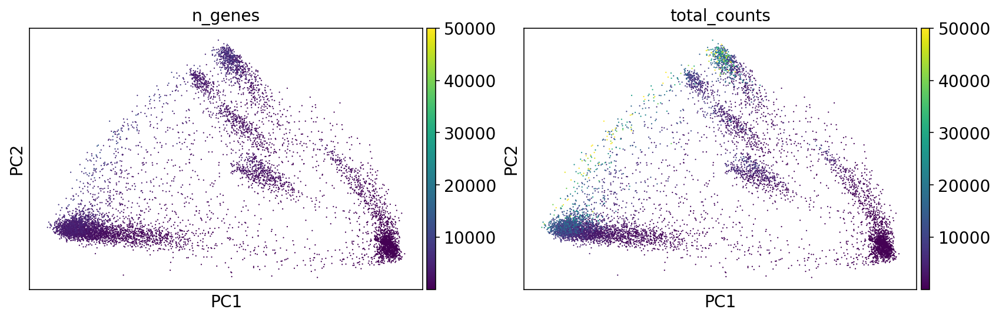

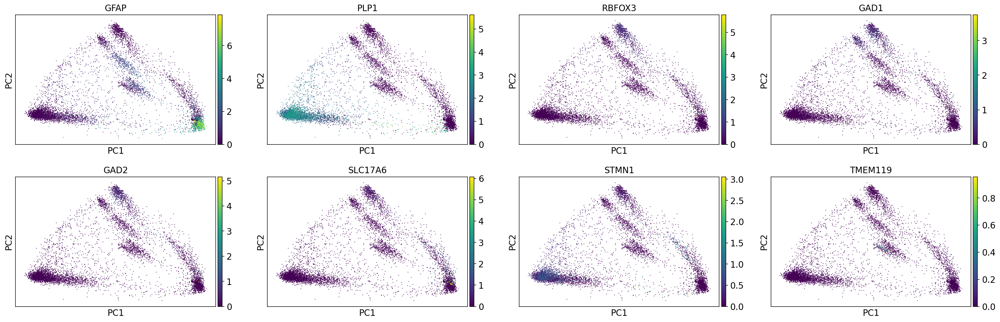

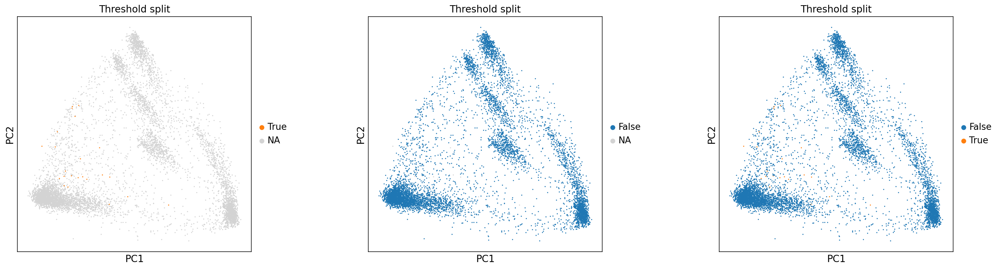

SRR12621868


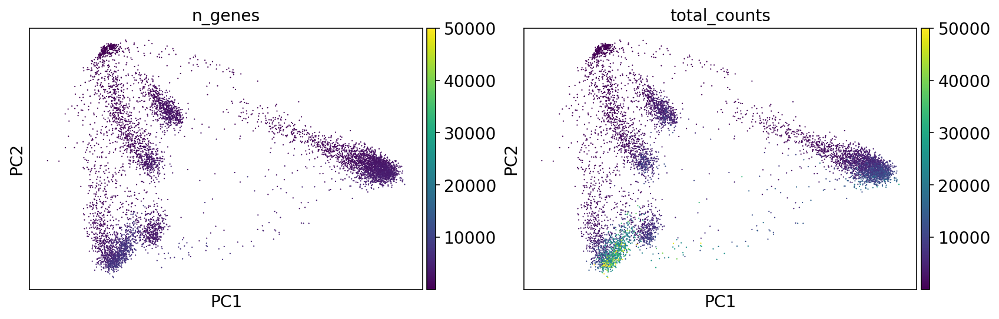

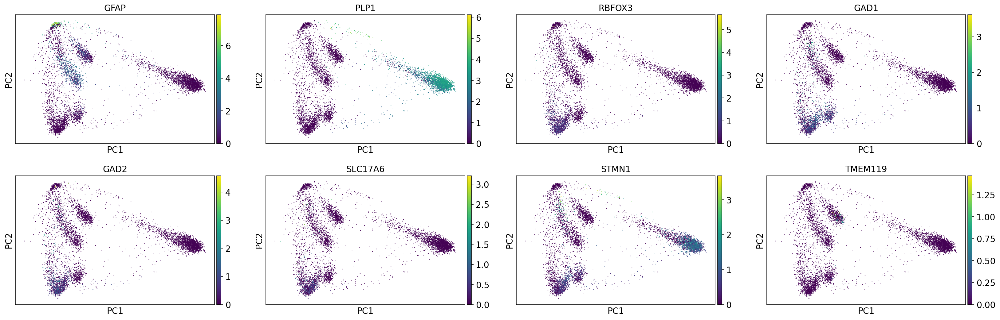

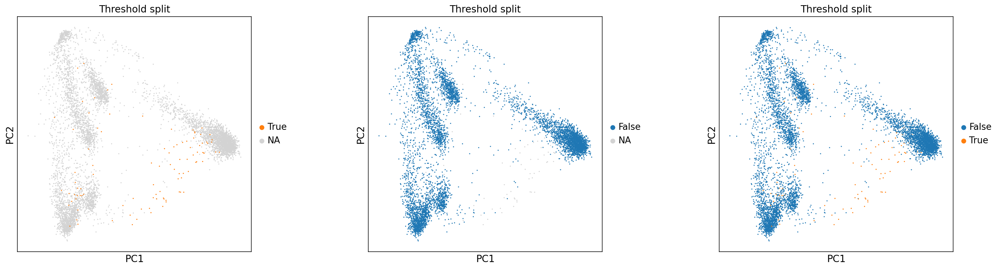

SRR12621870


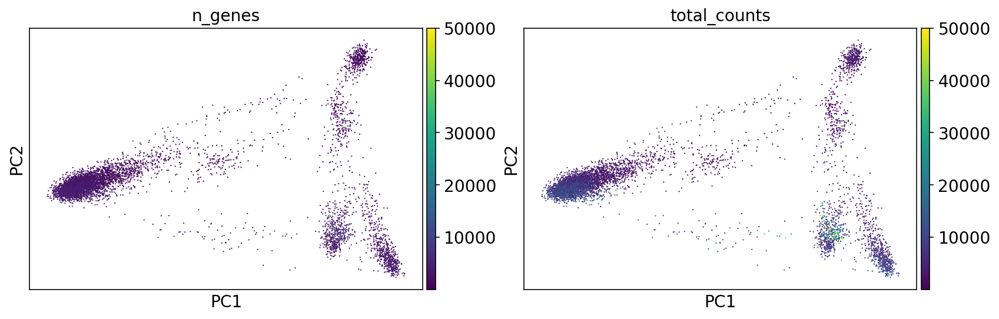

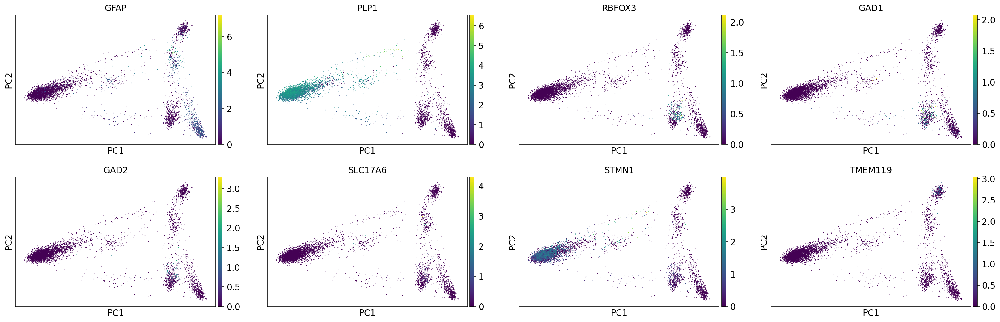

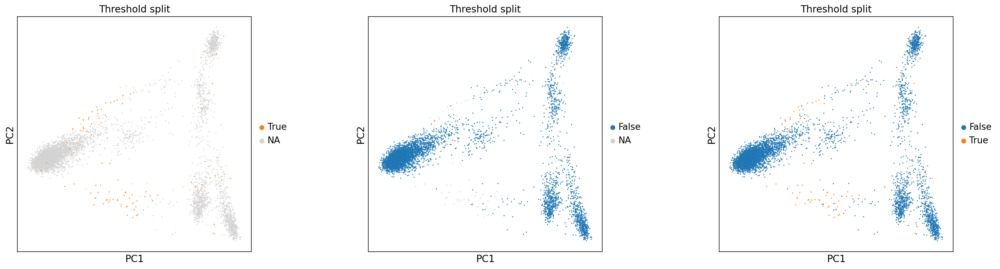

SRR12621871


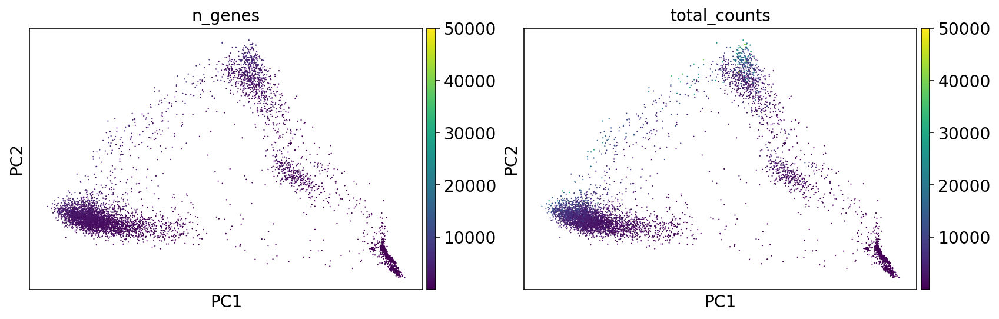

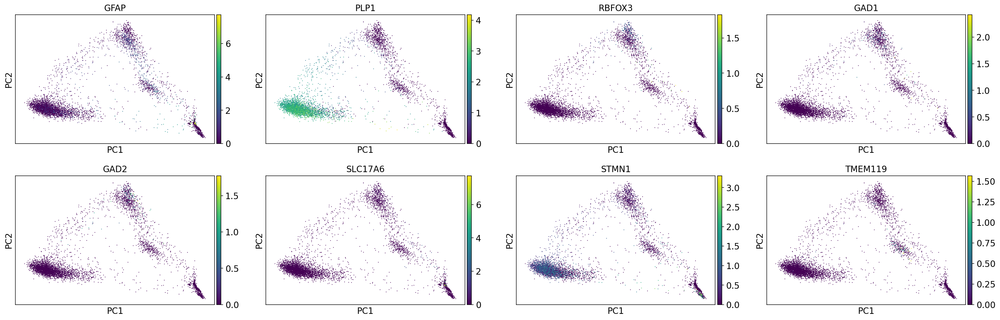

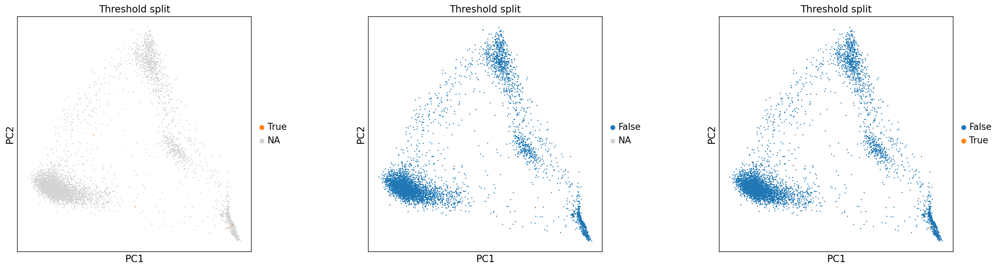

In [50]:
thr=[0.3,0.3,0,0.275,0.25]
for i in [0,1,3,4]:
    print(names[i])
    
    locals()['test_'+names[i]].obs['doublet_manual'] = np.where(np.array(locals()['test_'+names[i]].obs['doublet_score'] > thr[i]), 'True', 'False')
    
    sc.pl.pca(locals()['test_'+names[i]], color=['n_genes', 'total_counts'],s=5,vmax=50000)
    sc.pl.pca(locals()['test_'+names[i]], color=['GFAP', 'PLP1', 'RBFOX3','GAD1','GAD2', 'SLC17A6','STMN1','TMEM119'], s=5,use_raw=False)
    
    feature= 'doublet_manual'
    group1= 'True'
    group2= 'False'
    fig, axs = plt.subplots(1, 3, figsize =[24,6])
    #axs[-1, -1].axis('off')
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.5)
    sc.pl.pca(locals()['test_'+names[i]], color=feature, groups= group1, use_raw=False, s=10, ax= axs[0],show=False, title='Threshold split')
    sc.pl.pca(locals()['test_'+names[i]], color=feature, groups= group2, use_raw=False, s=10, ax= axs[1],show=False, title='Threshold split')
    sc.pl.pca(locals()['test_'+names[i]], color=feature, use_raw=False, s=10, ax= axs[2],show=False, title='Threshold split')
    
    plt.show()

SRR12621867


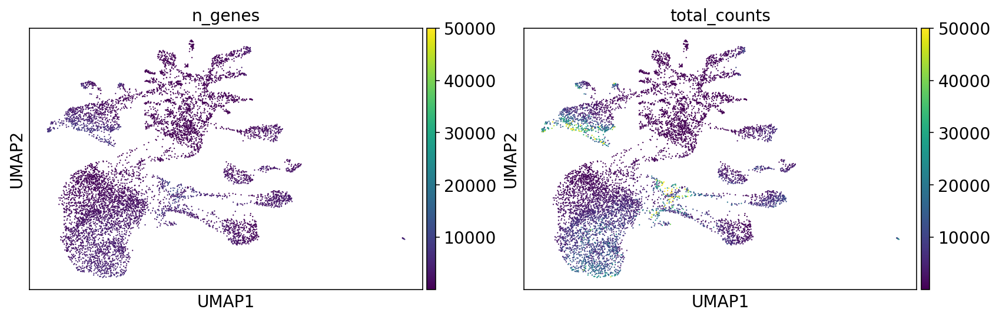

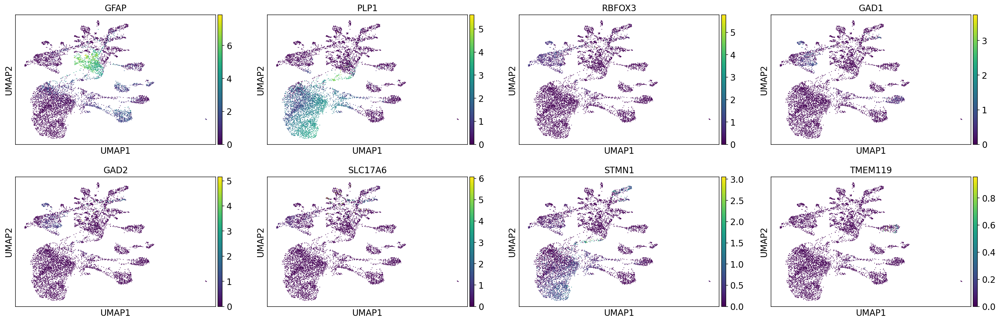

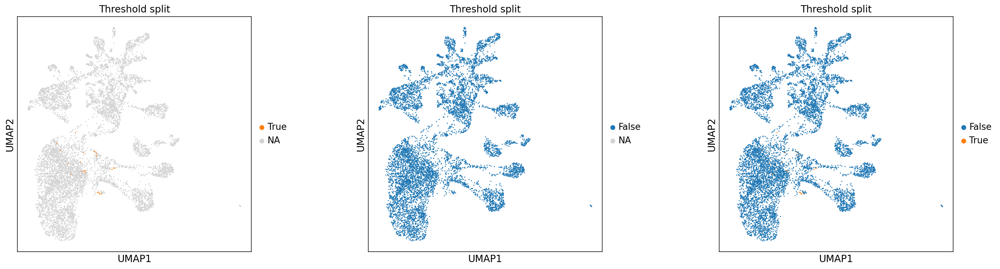

SRR12621868


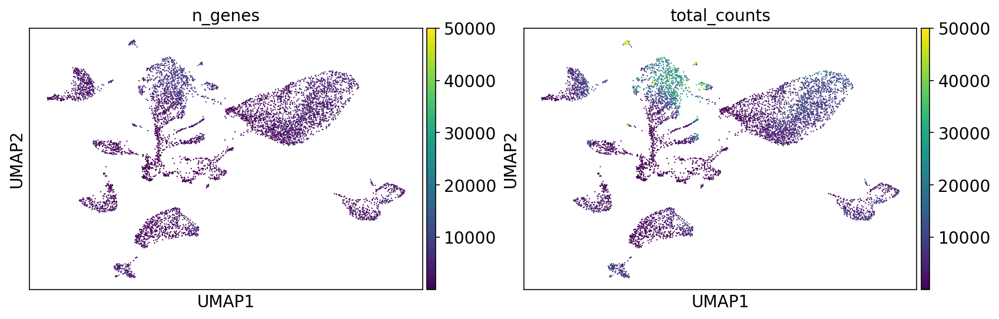

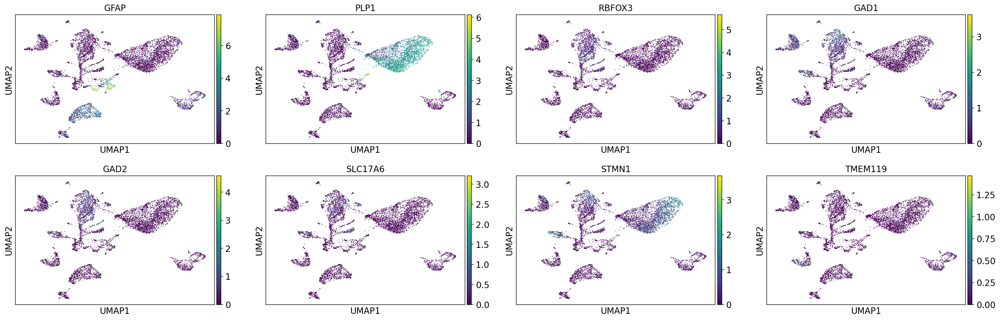

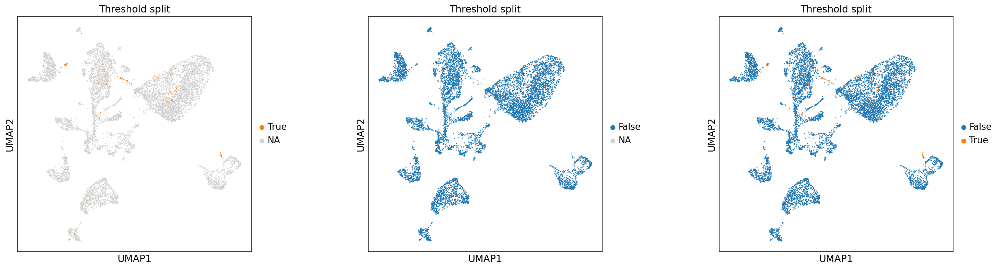

SRR12621870


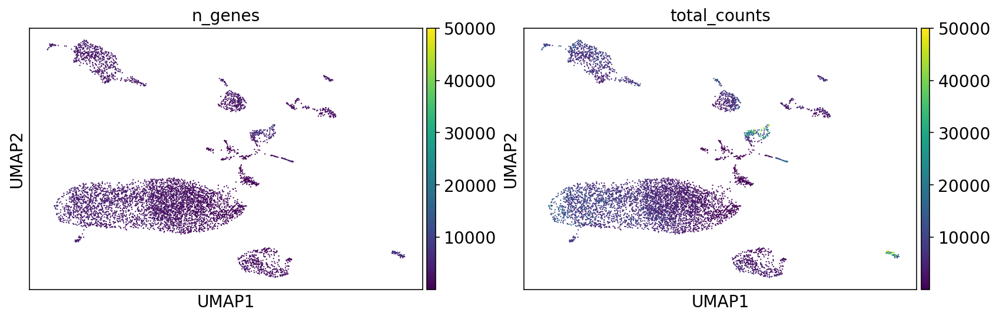

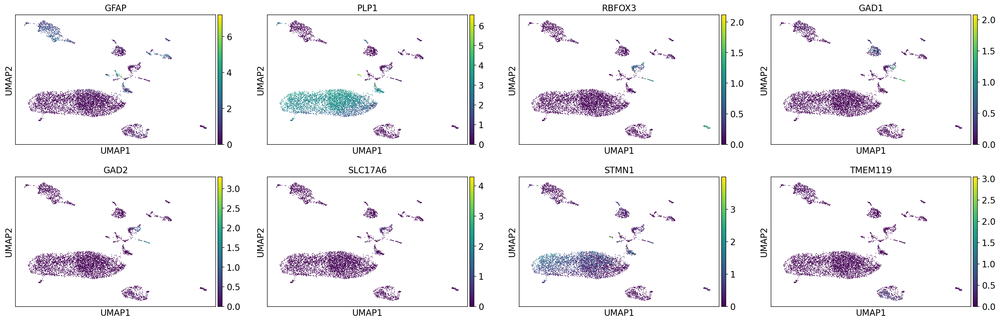

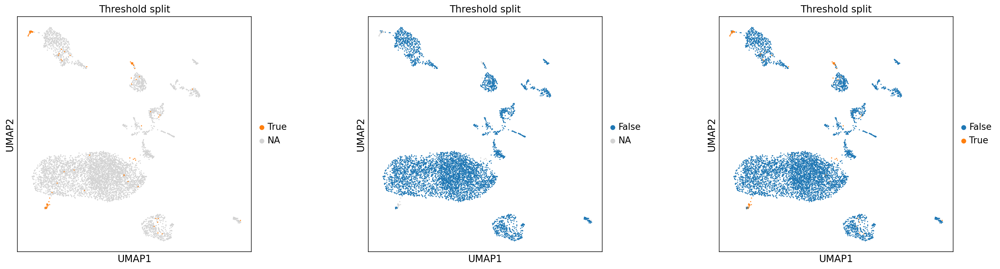

SRR12621871


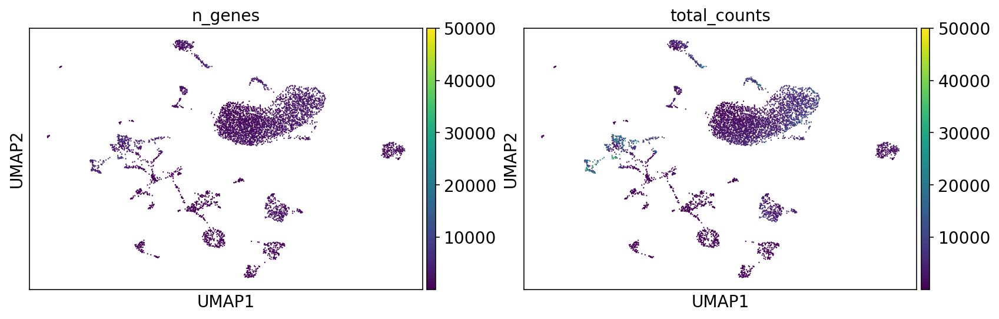

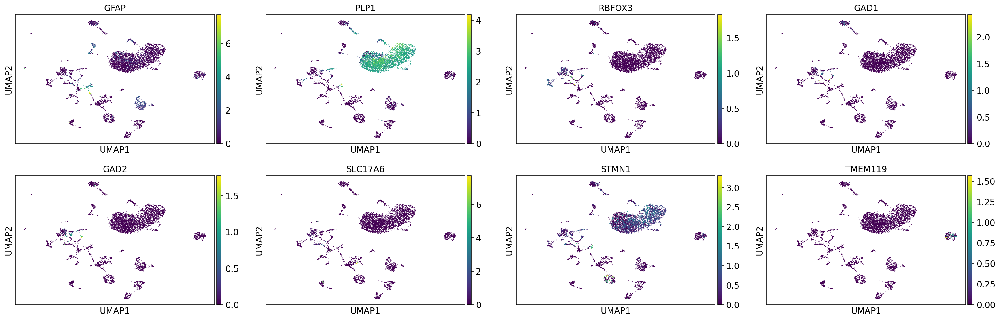

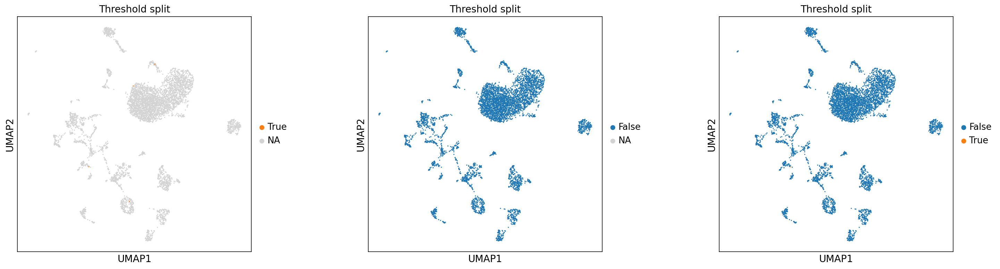

In [52]:

for i in [0,1,3,4]:
    print(names[i])
    
    sc.pl.umap(locals()['test_'+names[i]], color=['n_genes', 'total_counts'],s=5,vmax=50000)
    sc.pl.umap(locals()['test_'+names[i]], color=['GFAP', 'PLP1', 'RBFOX3','GAD1','GAD2', 'SLC17A6','STMN1','TMEM119'], s=5,use_raw=False)
    
    fig, axs = plt.subplots(1, 3, figsize =[24,6])
    #axs[-1, -1].axis('off')
    fig.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=0.5, hspace=0.5)
    sc.pl.umap(locals()['test_'+names[i]], color=feature, groups= group1, use_raw=False, s=10, ax= axs[0],show=False, title='Threshold split')
    sc.pl.umap(locals()['test_'+names[i]], color=feature, groups= group2, use_raw=False, s=10, ax= axs[1],show=False, title='Threshold split')
    sc.pl.umap(locals()['test_'+names[i]], color=feature, use_raw=False, s=10, ax= axs[2],show=False, title='Threshold split')
    plt.show()

<div class="alert alert-warning">
!
default scrublet threshold does not work well when there is no clear bimodal doublet score distribution, so we need to set our own based on trial and error. (though even with nice looking default threshold trial and error might be necessary)

SRR12621867 (dont change): try 0.30 -> seemed to be spread out in UMAP, pretty close to one supercluster, contains normal amount of counts -> indicating these are most likely not doublets \
\
SRR12621870(dont change, look at clusters forming): try 0.275 -> new predicted doublets form three clusters (no fully made of doublets) somewhere near a supercluster and spread out through the superclusters. This indicates a more strict threshold might remove the randomly dispersed doublets. \
\
SRR12621871 (dont change): try 0.25 or dont change -> only three data points with very little amount of counts, dont see obvious indications of being doublets\
\
SRR12621868: (0.22) doublet total count distribution looks a bit heavy on low side and mean counts between predicted doublets and rest is very similar -> try less strict threshold (0.3): this reduces some doublets within the superclusters and increases mean counts of doublets. (seems better)
\
All in all low suspicion, better to keep the strict threshold. So every sample retains it automatic threshold.


### Filtering - Doublets
Data points between clusters and in the middle of clusters with high count values are more likely to be doublets, but we can't be sure.

In [54]:
#max_doub_score = 0.2 

for i in range(numberobj):
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['predicted_doublet'] == 'False']
    print(object_names_preprocessed[i],': filtered!')

adata_SRR12621867_preprocessed : filtered!
adata_SRR12621868_preprocessed : filtered!
adata_SRR12621869_preprocessed : filtered!
adata_SRR12621870_preprocessed : filtered!
adata_SRR12621871_preprocessed : filtered!
adata_SRR12621872_preprocessed : filtered!


Recalculate values, especially total_counts and without ribo/mito pct change, because there is no mito genes anymore

In [55]:
for i in range(numberobj):
    sc.pp.calculate_qc_metrics(locals()[object_names_preprocessed[i]], expr_type='counts', var_type='genes', qc_vars=(), percent_top= (), layer= None, use_raw= False, inplace=True, log1p=True)
    print(object_names_preprocessed[i],': updated!')

/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_SRR12621867_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_SRR12621868_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_SRR12621869_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_SRR12621870_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_SRR12621871_preprocessed : updated!


/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_qc.py:135: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[obs_metrics.columns] = obs_metrics


adata_SRR12621872_preprocessed : updated!


## Preprocess - Mitochondrial and Ribosomal counts

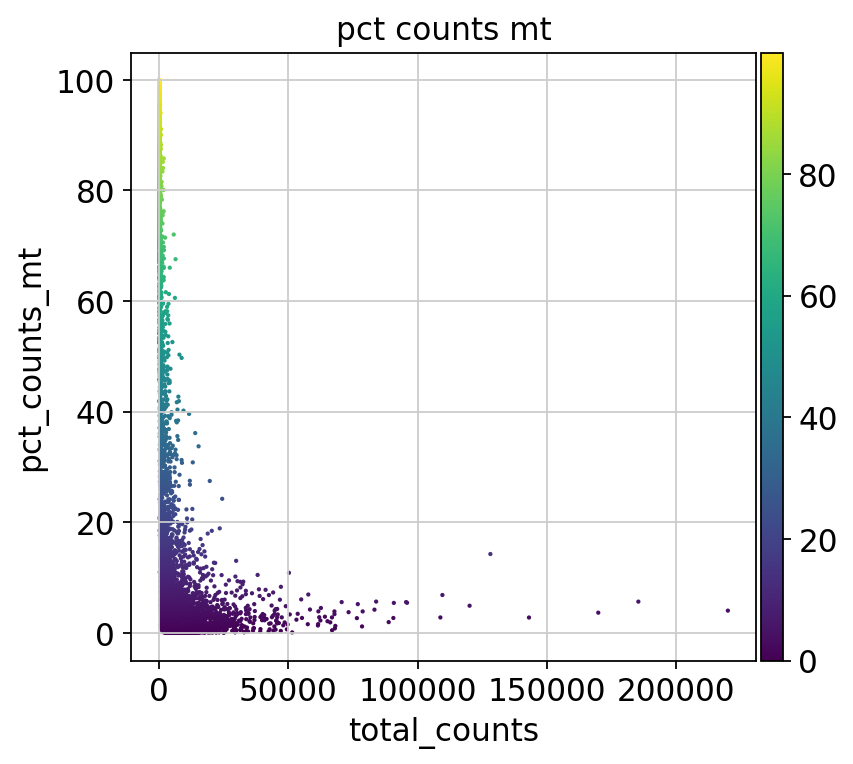

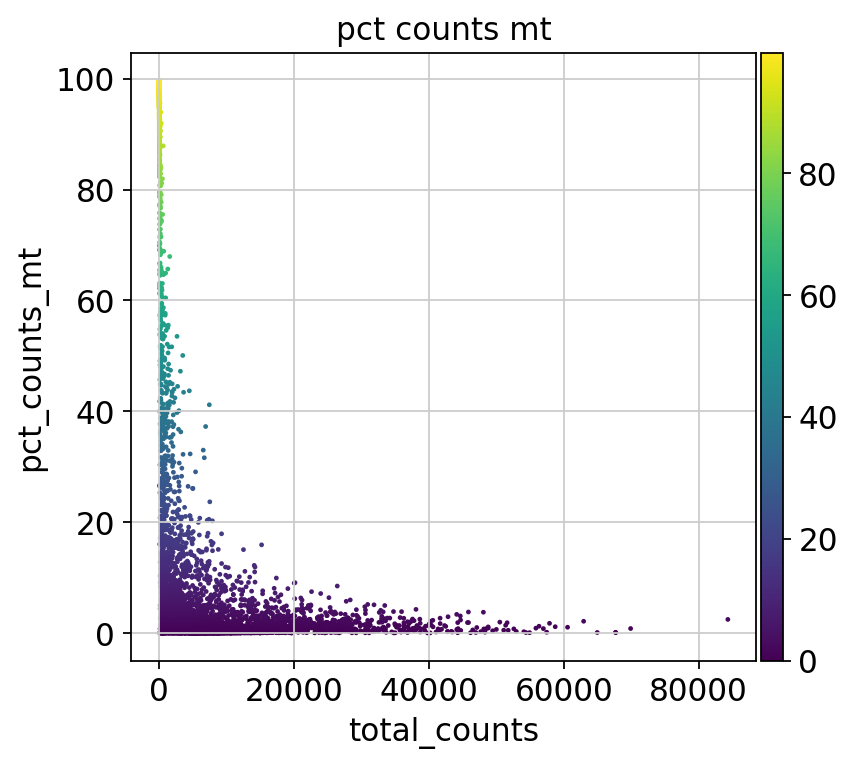

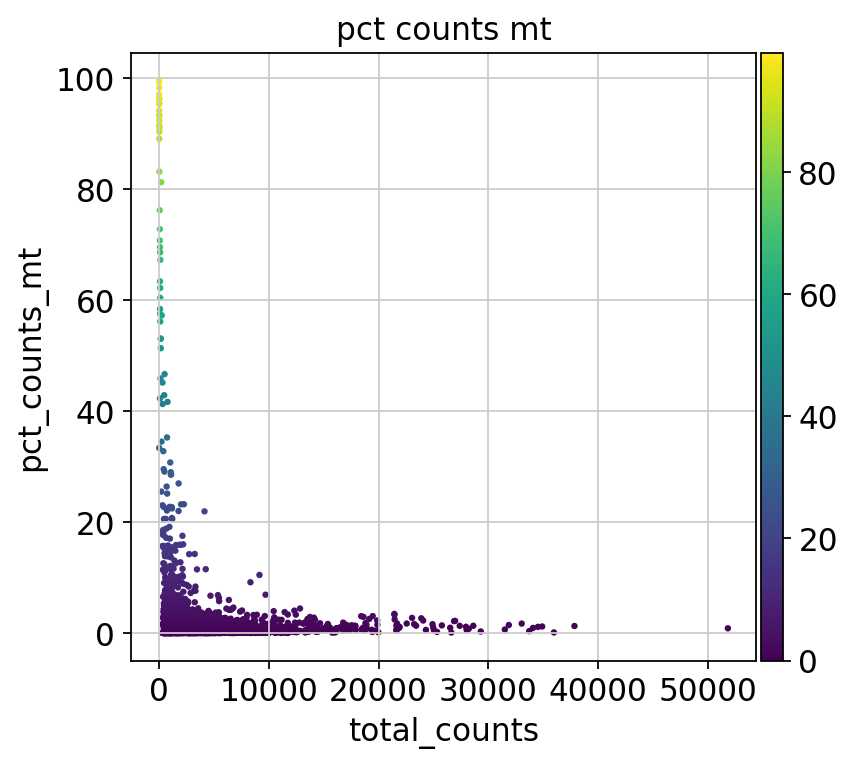

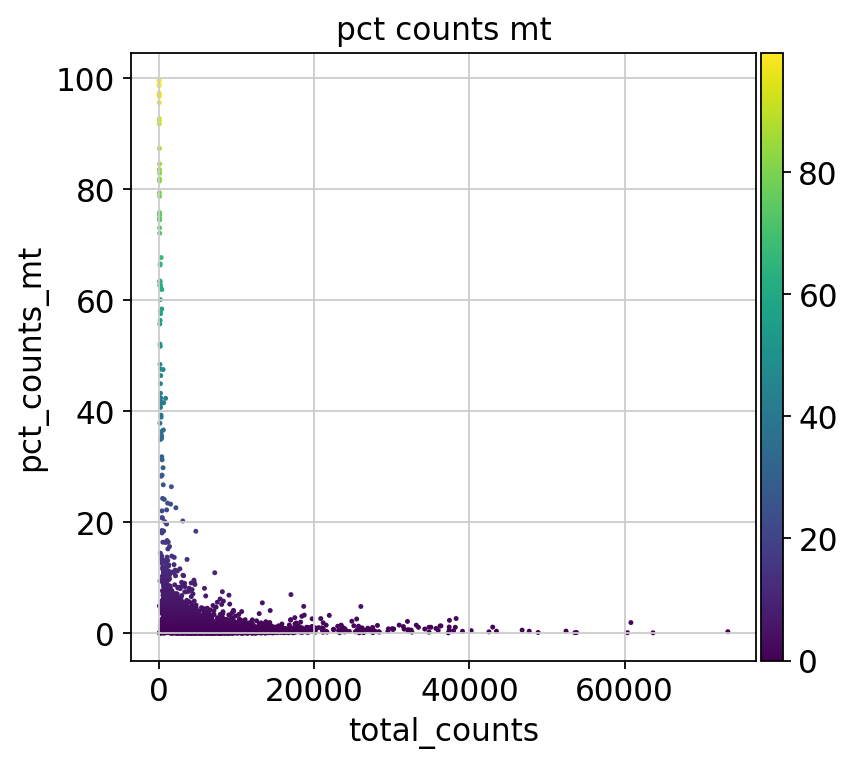

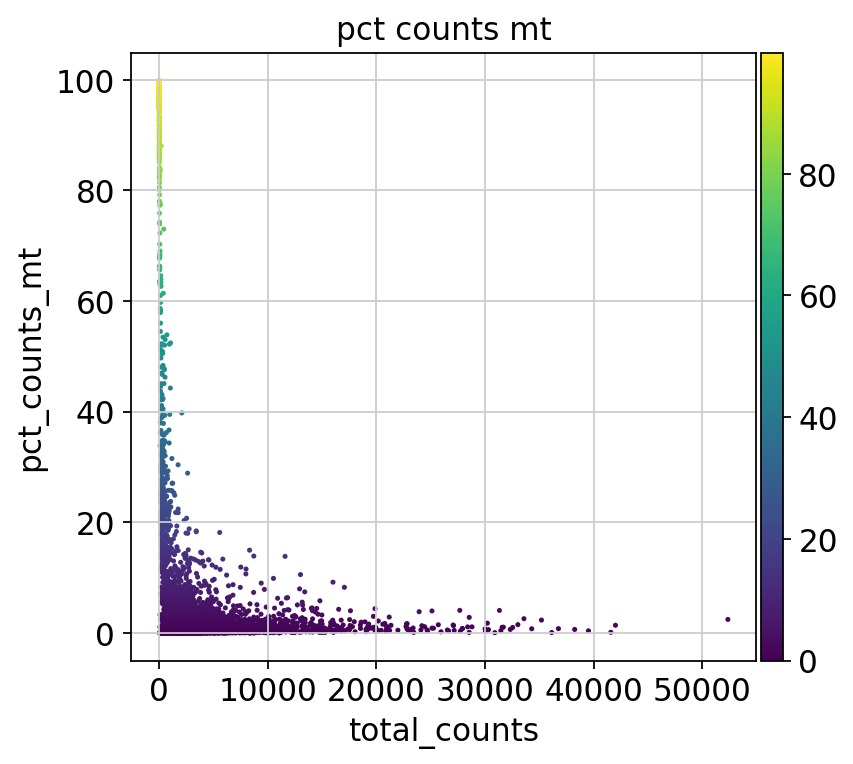

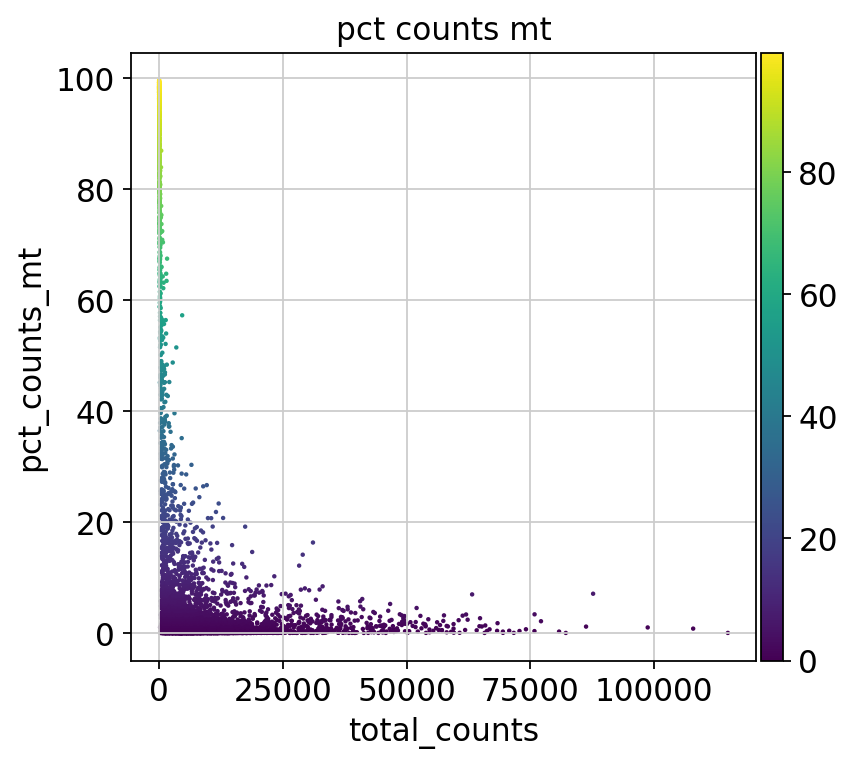

In [56]:
sc.set_figure_params(figsize=[5,5])
for i in range(numberobj):
    sc.pl.scatter(locals()[object_names_preprocessed[i]], x='total_counts', y='pct_counts_mt',color = 'pct_counts_mt',show=False)

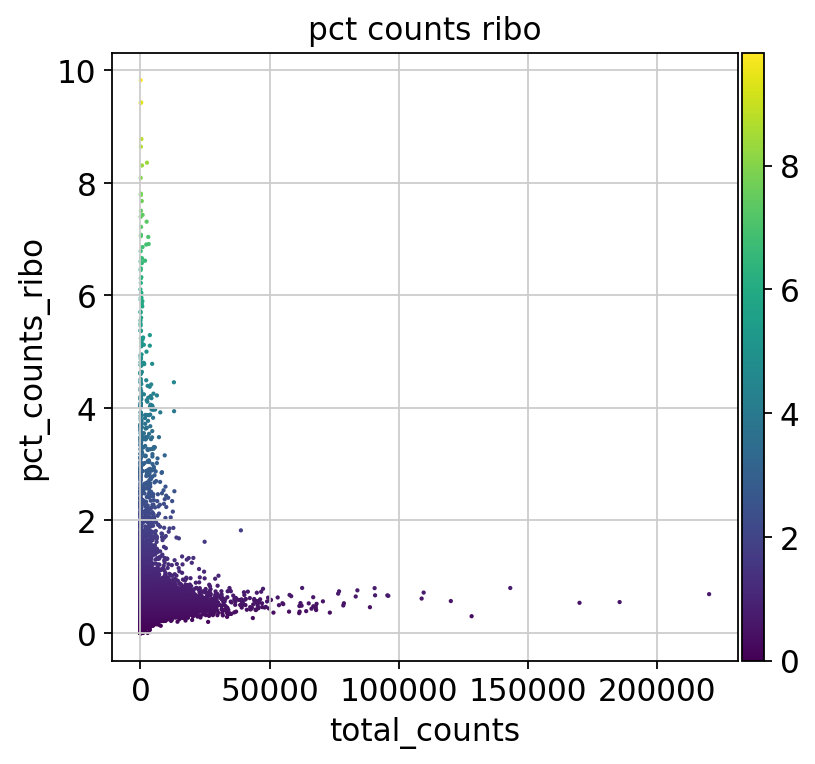

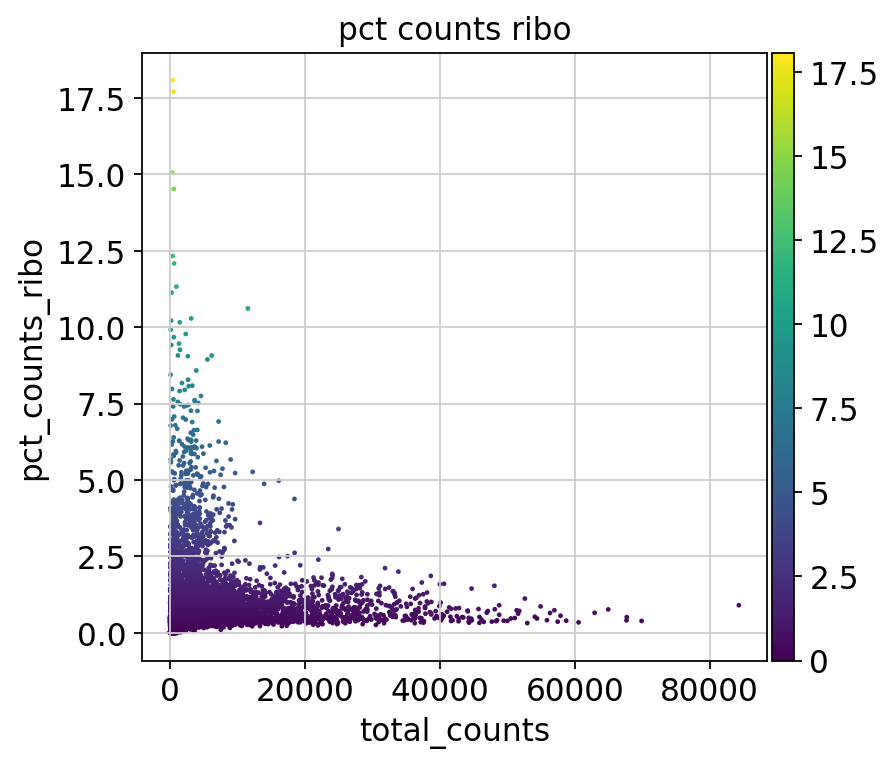

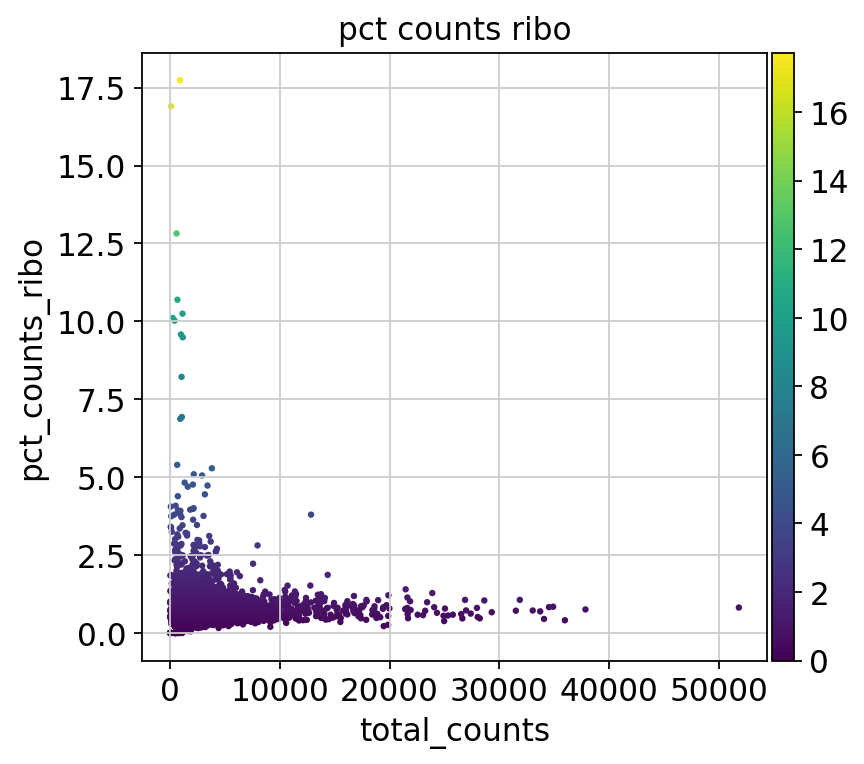

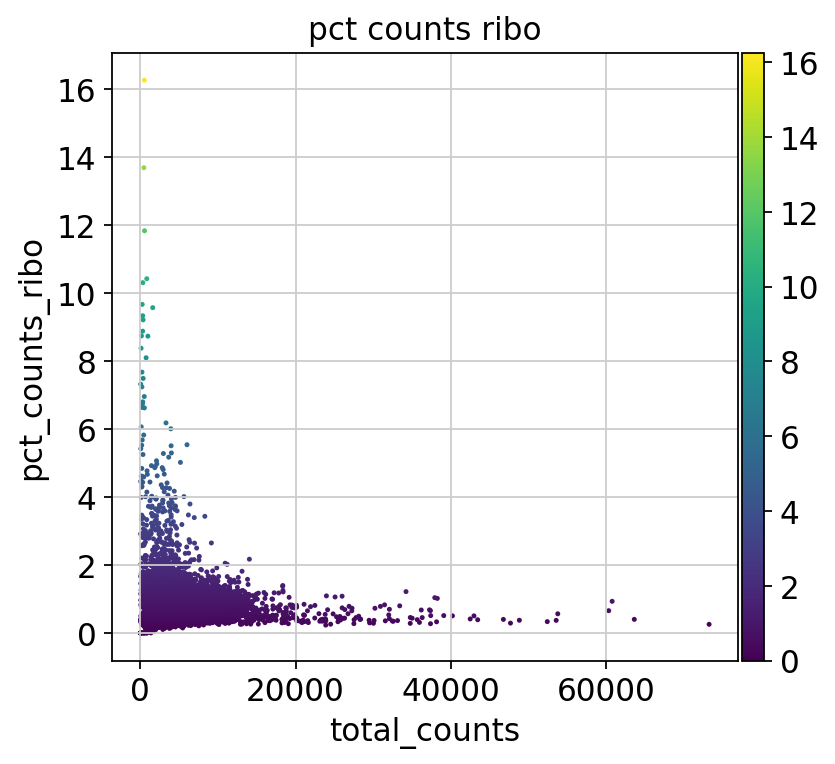

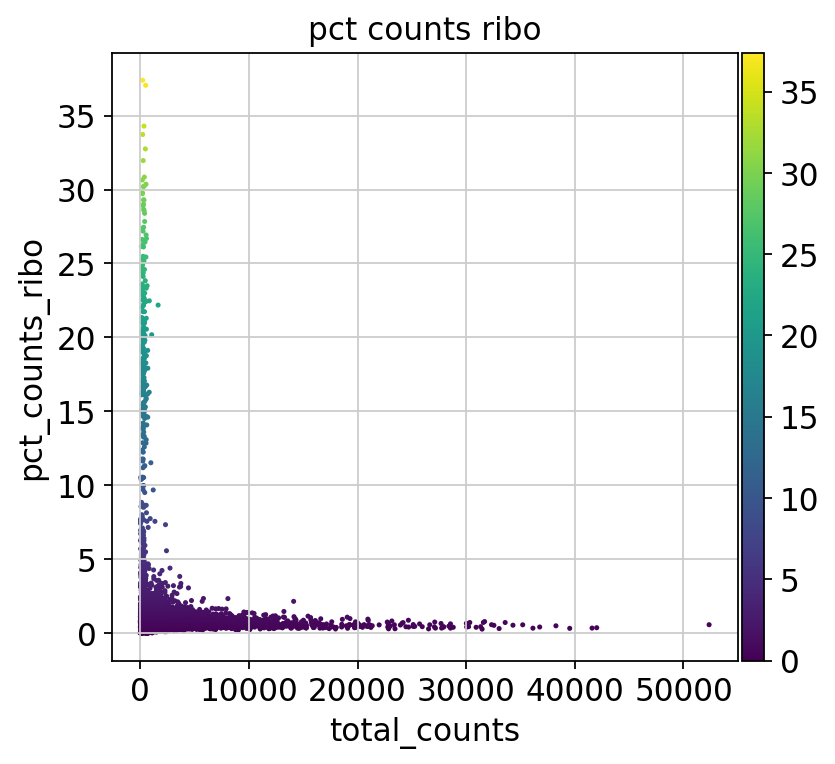

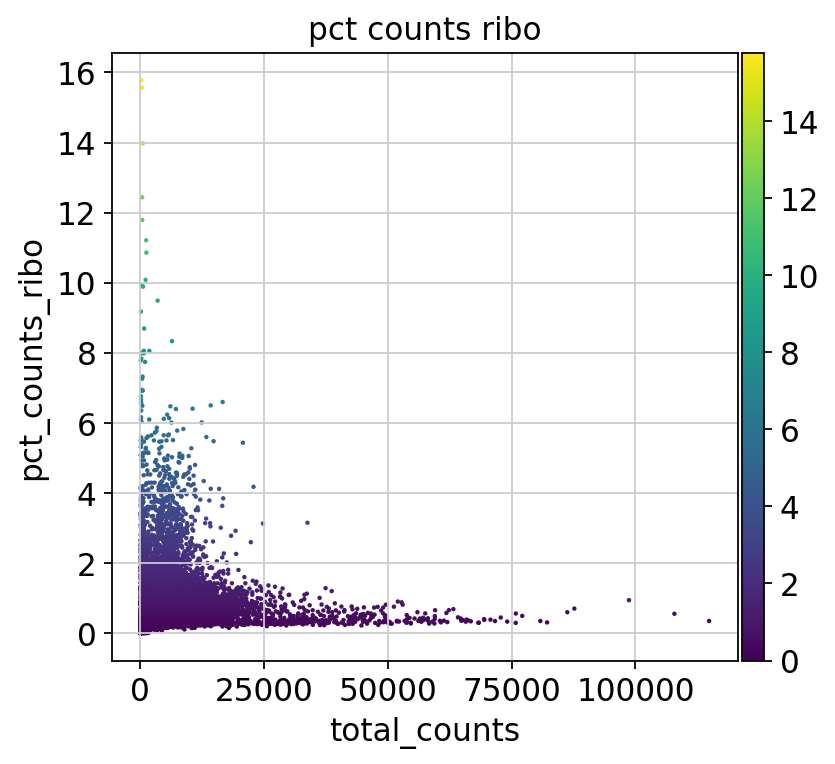

In [57]:
sc.set_figure_params(figsize=[5,5])
for i in range(numberobj):
    sc.pl.scatter(locals()[object_names_preprocessed[i]], x='total_counts', y='pct_counts_ribo',color = 'pct_counts_ribo',show=False)

### Filtering - Mitochondrial% and Ribosomal%
Try 10% first just like many other papers, see later if they form clusters... Smajic seem to have a lot of MT contamination -> dying cells

In [72]:
max_pct_mt = 10.0 
max_pct_ribo = 10.0 
for i in range(numberobj):
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['pct_counts_mt'] < max_pct_mt]
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['pct_counts_ribo'] < max_pct_ribo]

## Preprocess - UMIs and gene counts
Here, I want to use some different techniques to plot the data. This is not always necessary, however, you may want to have a close look at your data when you recieve something new. Seaborn package lets us make publication quality and diver plots, while a custom code from the Theis lab, built on Bokeh library, enables interactive plots 

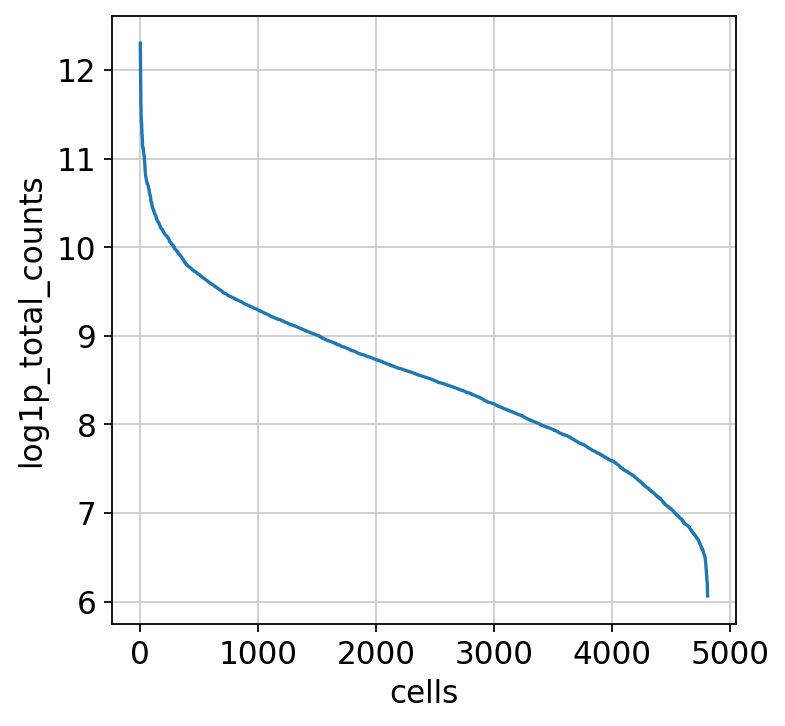

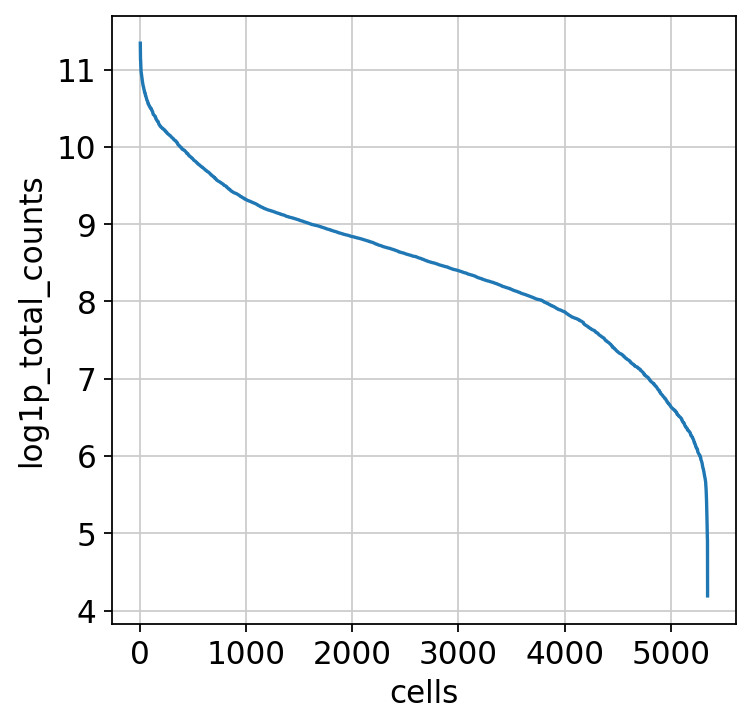

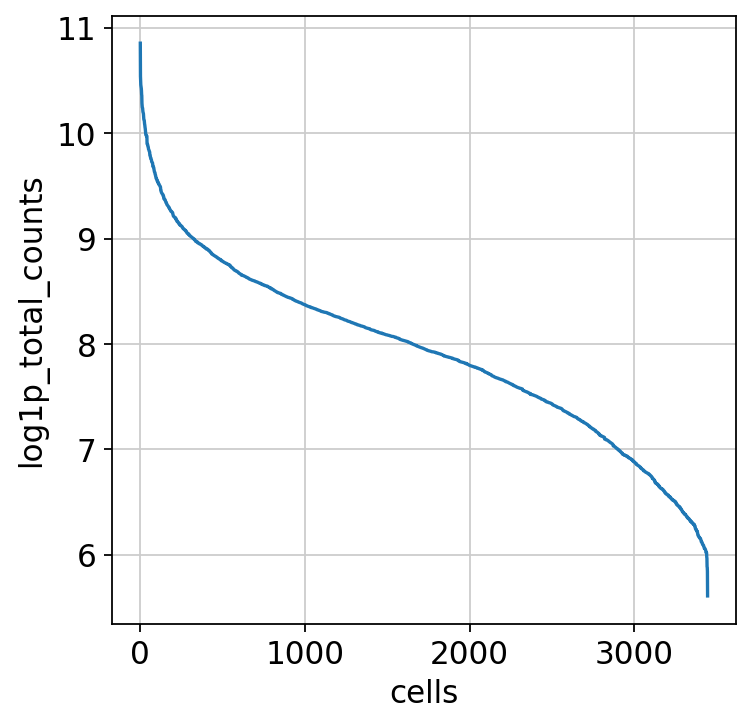

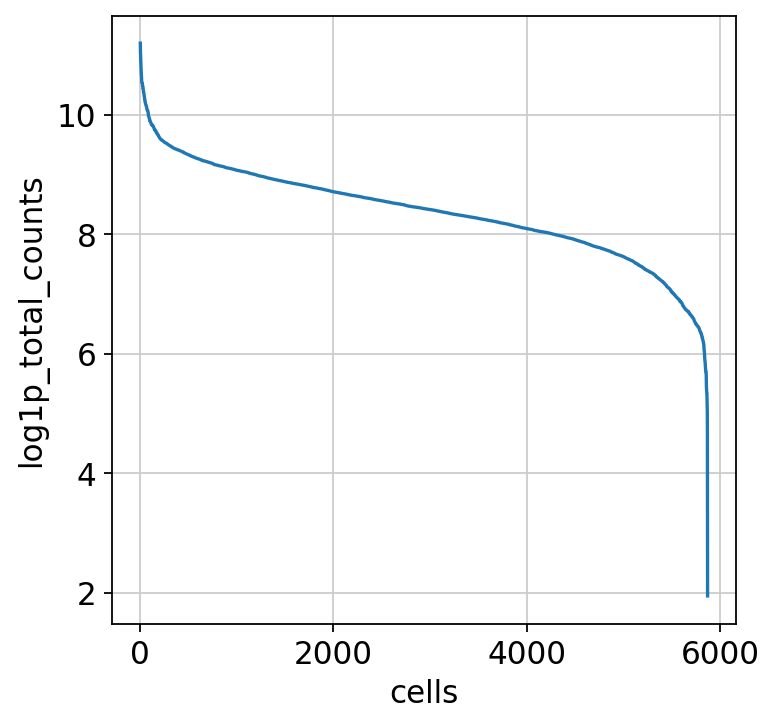

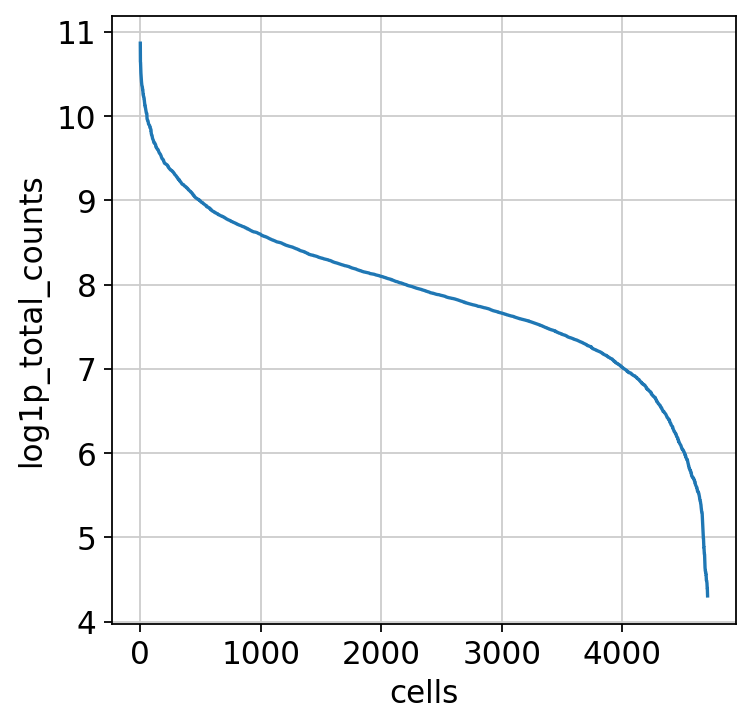

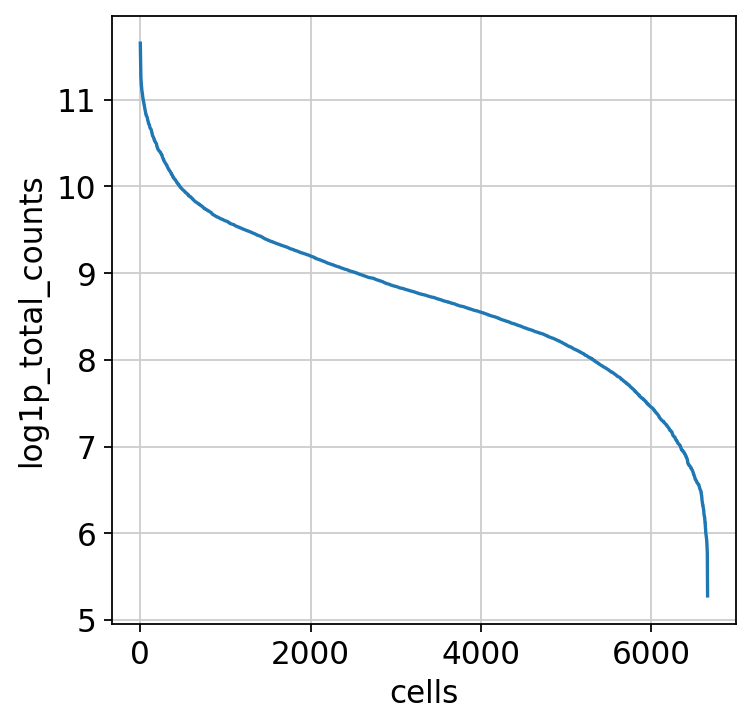

In [73]:
for i in range(numberobj):
    plt.figure()
    total_counts = locals()[object_names_preprocessed[i]].obs['log1p_total_counts'].sort_values(ascending = False)
    index = range(len(total_counts))
    plot = sns.lineplot( x = index, y=total_counts )
    plot.set(xlabel='cells')
    plt.show()

### Seaborn hex plots
These plots allow us to see the distribution of the number of genes and reads, as well as where they are most concentrated (dark colors)

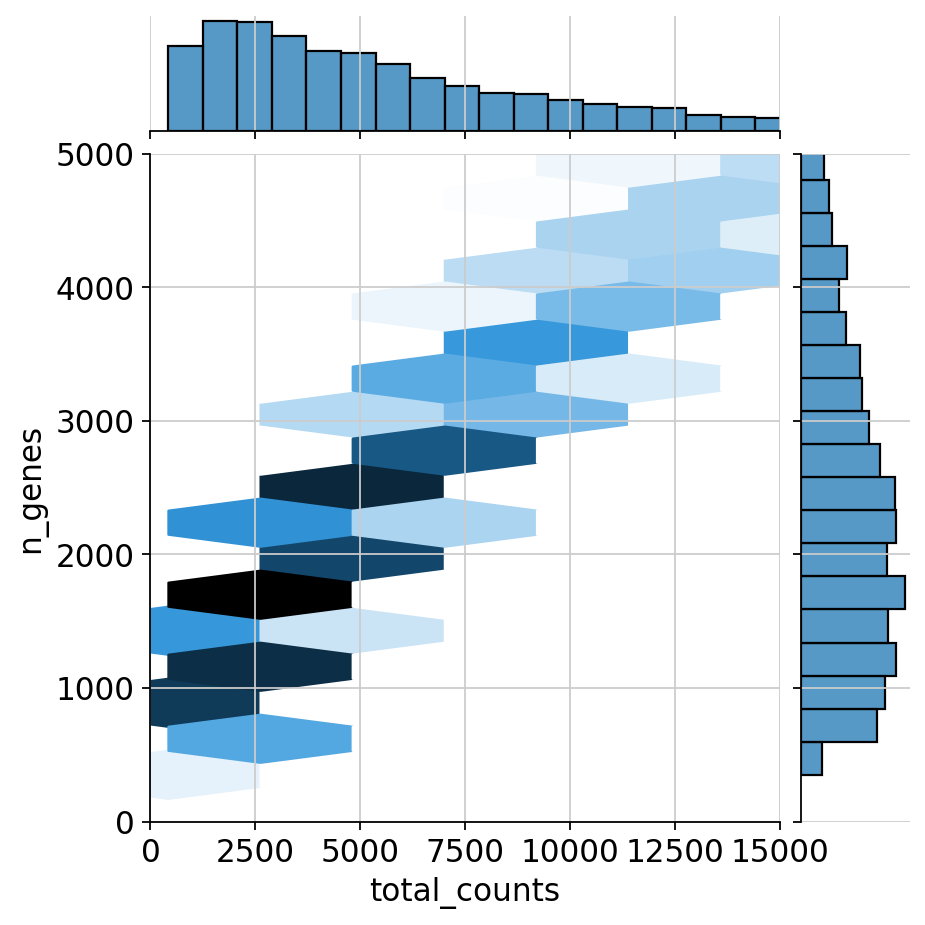

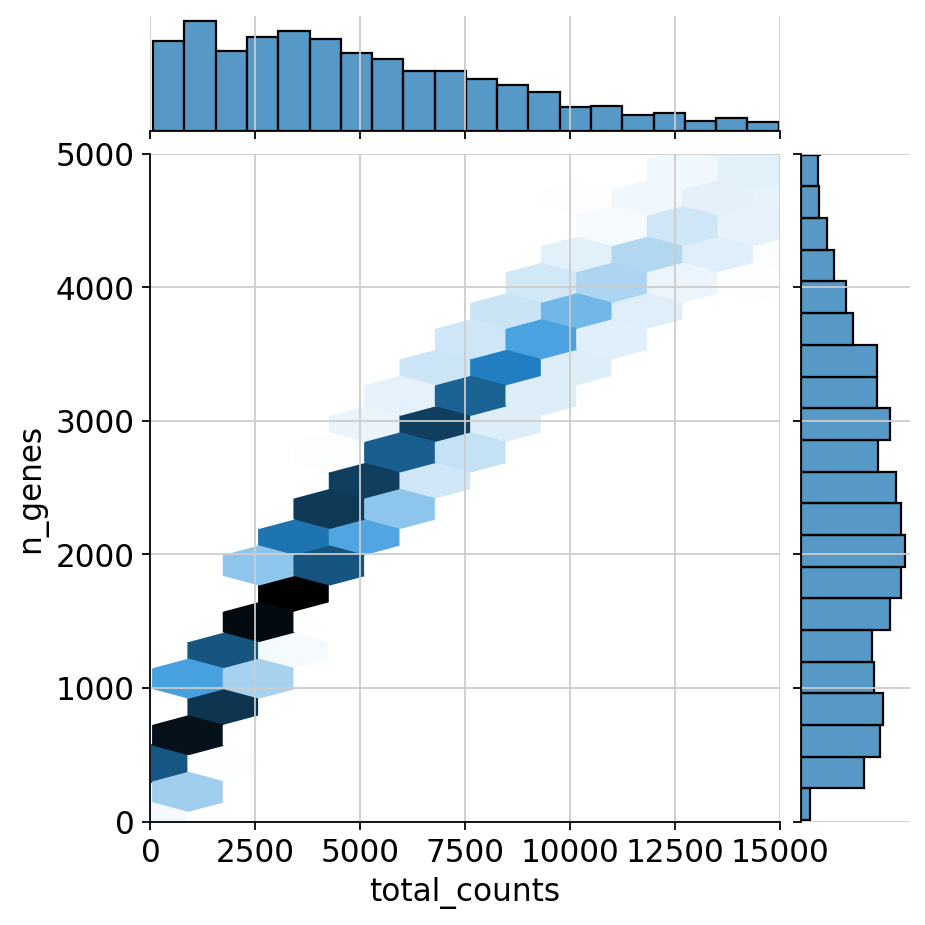

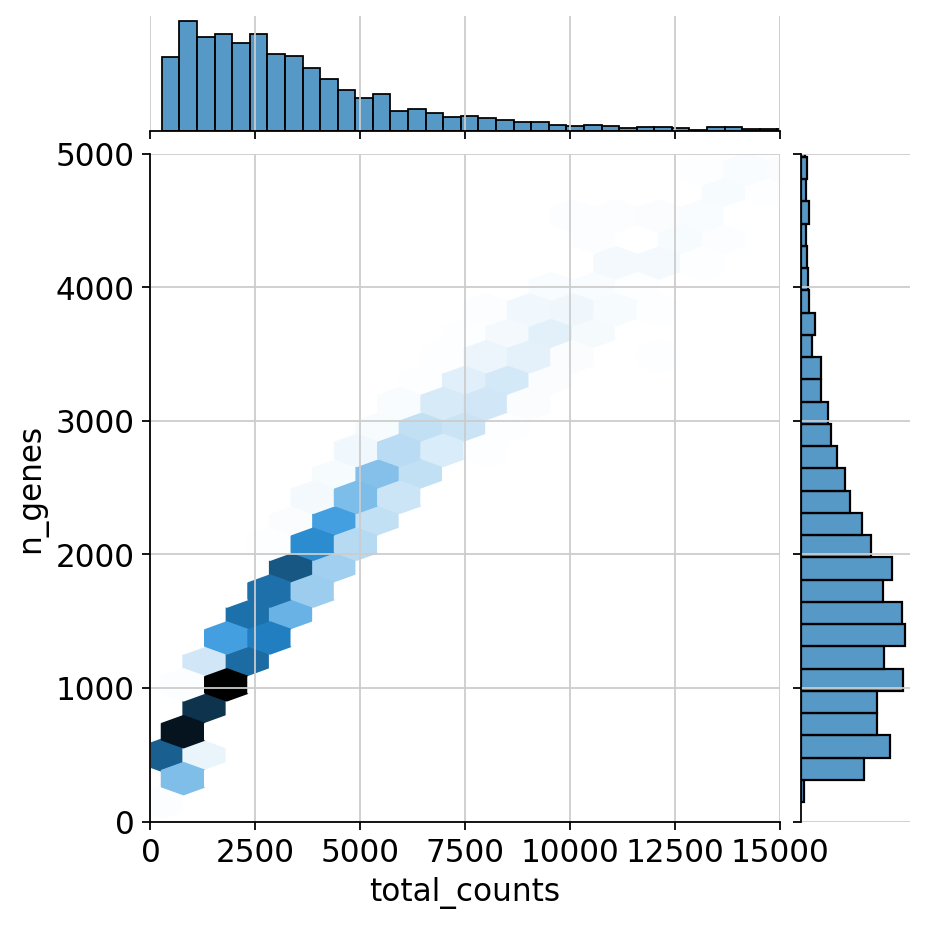

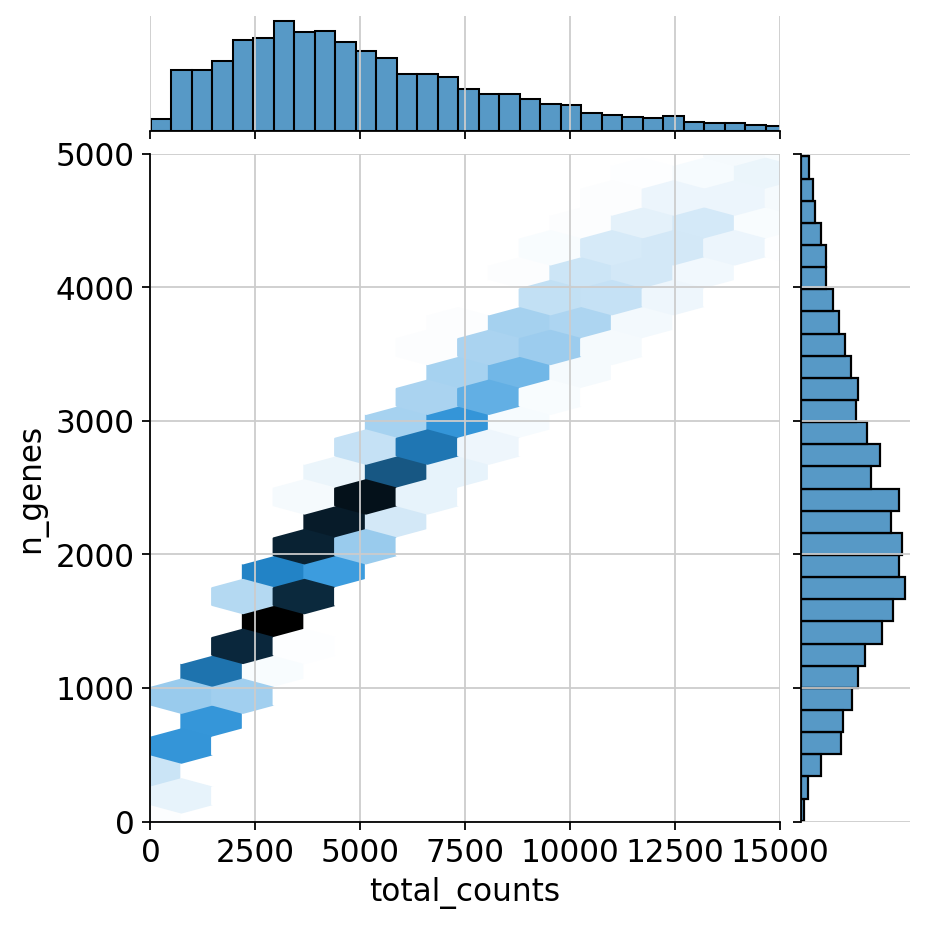

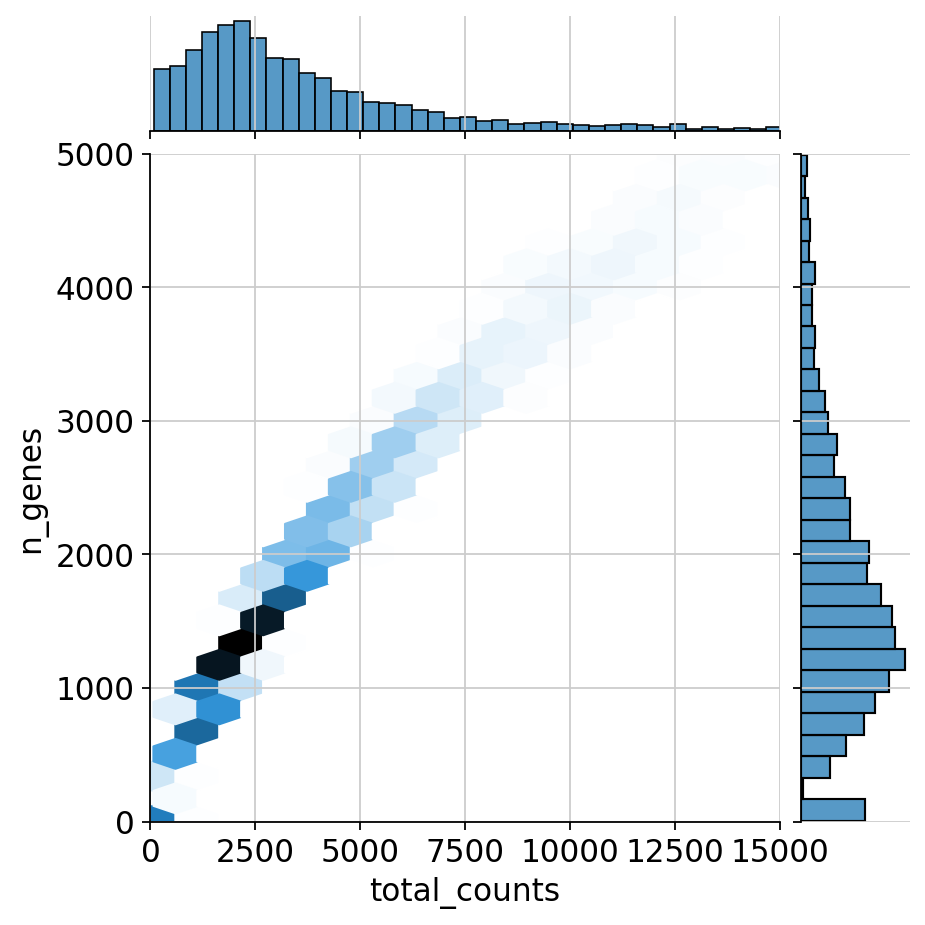

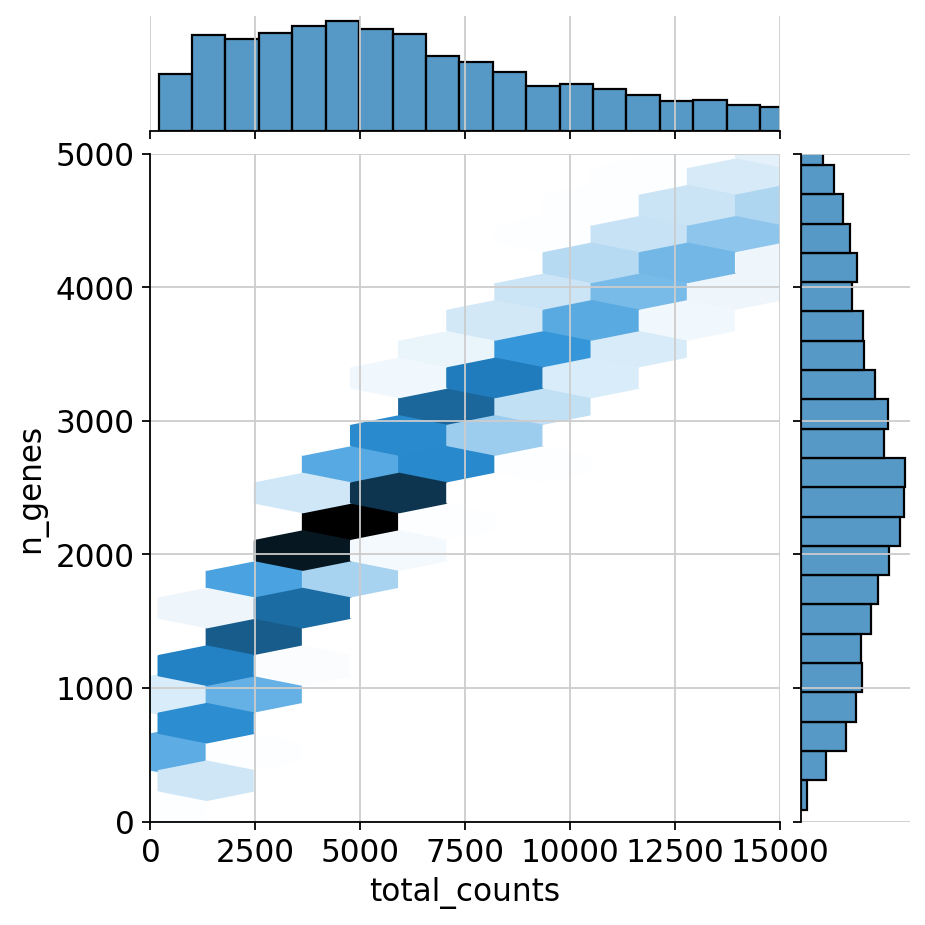

In [60]:
for i in range(numberobj):
    sns.jointplot( x= "total_counts", y= "n_genes", data=locals()[object_names_preprocessed[i]].obs, kind="hex",xlim=[0,15000], ylim=[0,5000])
#kind : { "scatter" | "reg" | "resid" | "kde" | "hex" }

### combined histogram plots
We can compare all libraries to each other using a seaborn histplot

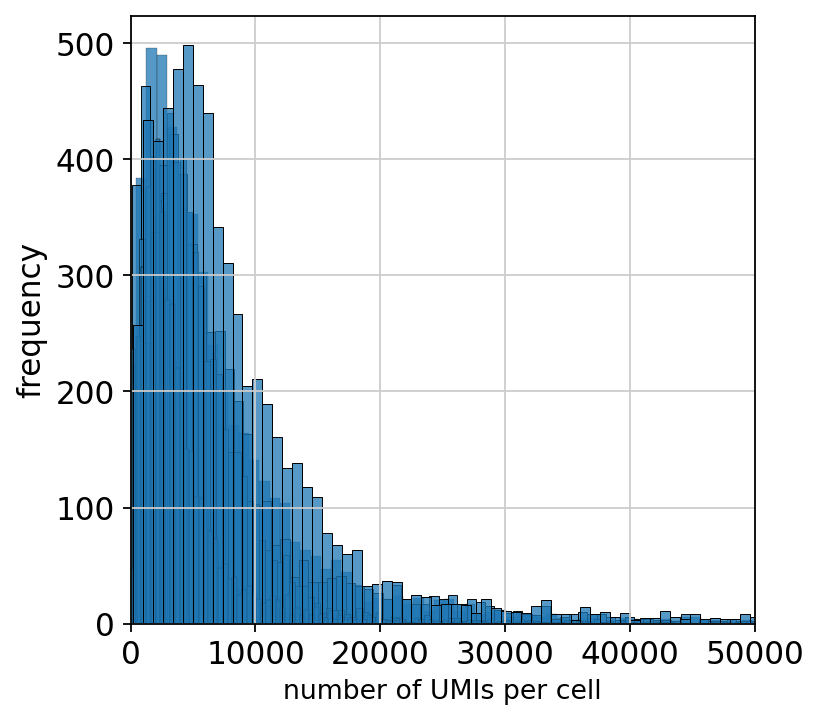

In [61]:

for i in range(numberobj):
    plot = sns.histplot(data=locals()[object_names_preprocessed[i]].obs,x= 'total_counts')
    plot.set_xlabel("number of UMIs per cell", fontsize = 12)
    plot.set_ylabel("frequency", fontsize = 14)
    plot.set_xlim(0,50000)

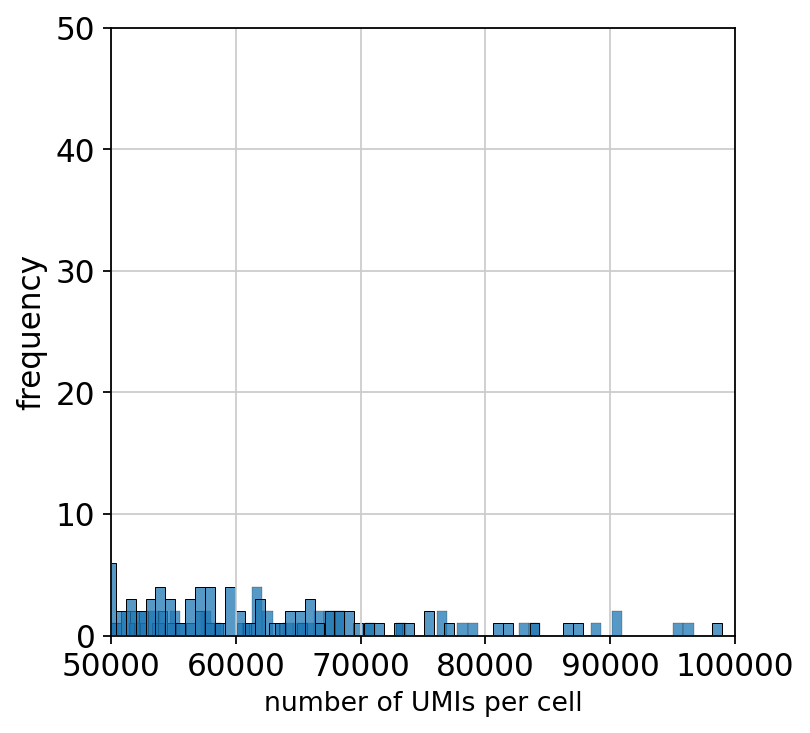

In [62]:

for i in range(numberobj):
    plot2 = sns.histplot(data=locals()[object_names_preprocessed[i]].obs,x= 'total_counts')
    plot2.set_xlabel("number of UMIs per cell", fontsize = 12)
    plot2.set_ylabel("frequency", fontsize = 14)
    plot2.set_xlim(50000,100000)
    plot2.set_ylim(0,50)

It seems ~70k might be good to start,but almost no atlas has a maximum UMI filter.

### Filtering - UMI and Gene 
Cells with unusual **low/high UMI** counts should be removed. Low counts could be droplets with only ambient RNA while high counts could be doublets. Here we won't filter out cells with high counts as they might represent a celltype. <br>
Similarly cells with unusual **low/high unique gene** counts should be removed. Low gene counts could be droplets with only ambient RNA while high gene counts could be multiplets. <br>
Nonetheless, these thresholds are sample specific and determining them is an iterative process. <br> 

Atlases generally don't have a max gene/UMI threshold as doublets are mostly filtered through methods such as scrublet.

<br>
NOTE: Cell Ranger Count function autmatically filtered out cells with less than 500 UMI counts (might not be the best for heterogenous data). <br>
For more information see: https://www.10xgenomics.com/resources/analysis-guides/common-considerations-for-quality-control-filters-for-single-cell-rna-seq-data 

In [74]:
min_counts = 500 #default
#max_counts = 50000
min_genes = 500
#max_genes = 10000
min_cells = 3



for i in range(numberobj):
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['total_counts']>=min_counts]
    #locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['total_counts'] < max_counts[i] ]
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['n_genes'] >= min_genes]
    #locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]][locals()[object_names_preprocessed[i]].obs['n_genes'] < max_genes]
    
    sc.pp.filter_genes(locals()[object_names_preprocessed[i]], min_cells=min_cells)

/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/miniconda3/envs/sc2_seurat/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
/hpc/hers_basak/bin/

### Recalculate metrics

In [75]:
for i in range(numberobj):
    sc.pp.calculate_qc_metrics(locals()[object_names_preprocessed[i]], expr_type='counts', var_type='genes', qc_vars=(), percent_top= (), layer= None, use_raw= False, inplace=True, log1p=True)
    print(locals()[object_names_preprocessed[i]])
    print(locals()[object_names_preprocessed[i]].obs['total_counts'])

AnnData object with n_obs × n_vars = 4789 × 30220
    obs: 'species', 'gender', 'age', 'instrument', 'technology', 'atlas', 'sample', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'n_genes', 'total_counts_mito'
    var: 'gene_ids', 'feature_types', 'genome', 'mt', 'ribo', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'scrublet'
AGGGTTTTCCTGGTCT-1    220053
TGTTGAGGTACGTACT-1    185432
CCTCCTCGTTAGAGTA-1    169920
AGTCAACGTCTAACGT-1    143100
CATGAGTAGCTAAATG-1    120131
                       ...  
CATCGTCAGTGCCCGT-1       621
AACAGGGAGACGACGT-1       644
TGATCTTTCGCCGAGT-1       713
GTCATGATCTTAGGAC-1       647
GATCACAGTCAGCTTA-1       682
Name: total_counts, Length: 4789, dtype: uint64
AnnD

In [76]:
object_names_filtered =list()

for i in range(numberobj):
    object_names_filtered.append("adata"+"_"+names[i])
    locals()[object_names_preprocessed[i]] = locals()[object_names_preprocessed[i]].copy()

In [77]:
for i in range(numberobj):
    locals()[object_names_preprocessed[i]].write(os.path.join('data/filtered_smajic_base_'+object_names_filtered[i][6:]+'.h5ad'))

In [78]:
!ls data

filtered_altena_base_g004.h5ad	filtered_smajic_base_SRR12621867.h5ad
filtered_altena_base_g005.h5ad	filtered_smajic_base_SRR12621868.h5ad
filtered_altena_base_g011.h5ad	filtered_smajic_base_SRR12621869.h5ad
filtered_altena_base_g012.h5ad	filtered_smajic_base_SRR12621870.h5ad
filtered_altena_base_g013.h5ad	filtered_smajic_base_SRR12621871.h5ad
filtered_altena_base_g014.h5ad	filtered_smajic_base_SRR12621872.h5ad
filtered_altena_base_g015.h5ad	filtered_smajic_doublets_SRR12621867.h5ad
filtered_altena_base_g016.h5ad	filtered_smajic_doublets_SRR12621868.h5ad
filtered_altena_base_g017.h5ad	filtered_smajic_doublets_SRR12621869.h5ad
filtered_altena_base_g018.h5ad	filtered_smajic_doublets_SRR12621870.h5ad
filtered_altena_base_g019.h5ad	filtered_smajic_doublets_SRR12621871.h5ad
filtered_altena_base_g020.h5ad	filtered_smajic_doublets_SRR12621872.h5ad
